- load data
- build labeled iterator
- build validation iterator
- build networks
- load pretrained network
- build PUMAP
- for each epoch
  - build umap graph
  - create data iterator
  - train epoch

In [1]:
# reload packages
%load_ext autoreload
%autoreload 2

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=2

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=2


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "cifar10"
dims = (32, 32, 3)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 4  #'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + "__learned-metric_augmented"
)
print(datestring)

cifar10_1.0_1024_4____2020_08_06_15_59_01_968264__learned-metric_augmented


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_CIFAR10, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_CIFAR10(flatten=False)
X_train.shape

(40000, 32, 32, 3)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build data iterators

In [10]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [11]:
batch_size = 256

In [12]:
img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
    rotation_range=10,       # random rotation degrees
    width_shift_range=0.1,   # random shift 10%
    height_shift_range=0.1,
    horizontal_flip=True,
    brightness_range = (0.5, 1.5),
    ##rescale = 0.1,
    zoom_range = 0.2,
    rescale=1./255,  
    #shear_range = 6,
    ##zca_whitening = True,
)

In [13]:
labeled_batch_size = 128
labeled_iter = tf.data.Dataset.from_generator(
    lambda: img_data_gen.flow(X_labeled, y=Y_labeled, batch_size=labeled_batch_size),
    (tf.float32, tf.int32),
).prefetch(10)#.batch(10)

In [14]:
X, y = next(iter(labeled_iter))

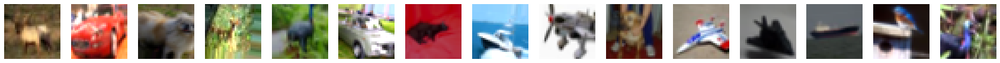

In [15]:
# view augmentations
nex = 15
fig, axs = plt.subplots(ncols=nex, figsize=(nex*2, 2))
for i in range(nex):
    axs[i].imshow(X[i])
    axs[i].axis('off')

In [16]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [17]:

from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

block_layers_num = 3
weight_decay = 1e-4
name = 'resnet20'
def conv2d_bn(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = Conv2D(filters=filters,
                   kernel_size=kernel_size,
                   strides=strides,
                   padding='same',
                   use_bias=False,
                   kernel_regularizer=l2(weight_decay)
                   )(x)
    layer = BatchNormalization()(layer)
    return layer


def conv2d_bn_relu(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = conv2d_bn(x, filters, kernel_size, weight_decay, strides)
    layer = Activation('relu')(layer)
    return layer


def ResidualBlock(x, filters, kernel_size, weight_decay, downsample=True):
    if downsample:
        # residual_x = conv2d_bn_relu(x, filters, kernel_size=1, strides=2)
        residual_x = conv2d_bn(x, filters, kernel_size=1, strides=2)
        stride = 2
    else:
        residual_x = x
        stride = 1
    residual = conv2d_bn_relu(x,
                              filters=filters,
                              kernel_size=kernel_size,
                              weight_decay=weight_decay,
                              strides=stride,
                              )
    residual = conv2d_bn(residual,
                         filters=filters,
                         kernel_size=kernel_size,
                         weight_decay=weight_decay,
                         strides=1,
                         )
    out = layers.add([residual_x, residual])
    out = Activation('relu')(out)
    return out



input_ = Input(shape=dims)
x =input_
x = conv2d_bn_relu(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, strides=(1, 1))

# # conv 2
for i in range(block_layers_num):
    x = ResidualBlock(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 3
x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 4
x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
x = AveragePooling2D(pool_size=(8, 8), padding='valid')(x)
x = Flatten()(x)
encoder = Model(input_, x, name=name)

In [18]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=64))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [19]:
encoder.summary()

Model: "resnet20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   432         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization[0][0]        
___________________________________________________________________________________________

### load weights

In [20]:
from umap import UMAP

In [21]:
from tfumap.paths import MODEL_DIR

In [22]:
load_loc = "cifar10_1.0_1024_4____2020_08_01_17_37_09_358973_augmented"
encoder.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "encoder").as_posix())
classifier.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "classifier").as_posix())

### Look at pretrained state

In [23]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [24]:
pred_model = tf.keras.models.Model(classifier.input,[classifier.get_layer(name="dense_1").get_output_at(0)])

In [25]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

In [26]:
valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.2158


In [27]:
umap_class = UMAP(verbose=True).fit_transform(last_layer_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 15:59:33 2020 Finding Nearest Neighbors
Thu Aug  6 15:59:33 2020 Building RP forest with 10 trees
Thu Aug  6 15:59:34 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 15:59:48 2020 Finished Nearest Neighbor Search
Thu Aug  6 15:59:51 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 16:00:05 2020 Finished embedding


In [28]:
conf_thresh =  0.99
conf_mask = confidence > conf_thresh
umap_class_conf = UMAP(verbose=True).fit_transform(last_layer_class[conf_mask])

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 16:00:06 2020 Finding Nearest Neighbors
Thu Aug  6 16:00:06 2020 Building RP forest with 9 trees
Thu Aug  6 16:00:06 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 16:00:06 2020 Finished Nearest Neighbor Search
Thu Aug  6 16:00:06 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 16:00:17 2020 Finished embedding


In [29]:
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_valid

Text(0.5, 1.0, 'Confidence')

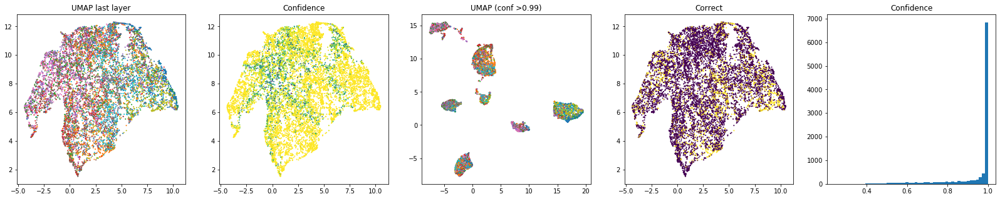

In [30]:
fig, axs = plt.subplots(ncols = 5, figsize=(28,5))
axs[0].scatter(umap_class[:,0], umap_class[:,1], s=1, c = Y_valid, cmap = plt.cm.tab10)
axs[0].set_title('UMAP last layer')
axs[1].scatter(umap_class[:,0], umap_class[:,1], s=1, c = confidence, cmap = plt.cm.viridis)
axs[1].set_title('Confidence')
axs[2].scatter(umap_class_conf[:,0], umap_class_conf[:,1], s=1, c = Y_valid[conf_mask], cmap = plt.cm.tab10)
axs[2].set_title('UMAP (conf >{})'.format(conf_thresh) )
axs[3].scatter(umap_class[:,0], umap_class[:,1], s=1, c = correctness, cmap = plt.cm.viridis)
axs[3].set_title('Correct')
axs[4].hist((confidence), bins = 50);
axs[4].set_title('Confidence')

In [31]:
len(z_pred[Y_valid])

10000

In [32]:
correct_pred =[i[j] for i,j in zip(z_pred, Y_valid)]

Text(0, 0.5, 'correct_pred')

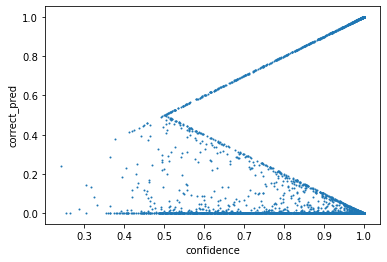

In [33]:
plt.scatter(confidence, correct_pred, s=1)
plt.xlabel('confidence')
plt.ylabel('correct_pred')

### Create UMAP object

In [34]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [35]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [36]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [37]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [38]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=3, figsize=(14, 10), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(13.4,3))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


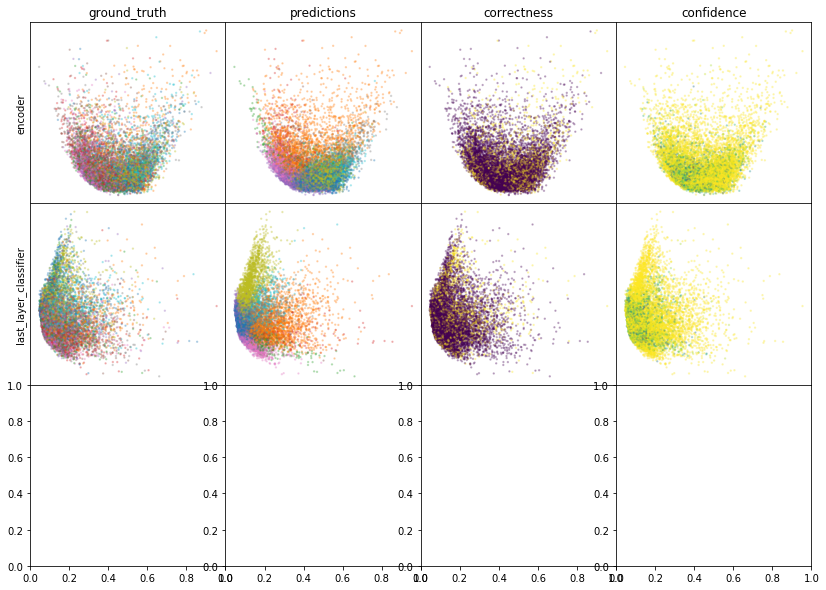

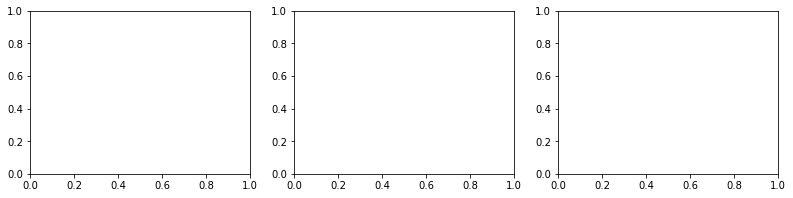

In [39]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

In [40]:
for i in tqdm(range(100)):
    test = next(img_data_gen.flow(X_labeled[:128], batch_size=128, shuffle=False))

In [41]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

    def augmentation_generator():  # edges_to, edges_from, batch_size
        """
        https://github.com/keras-team/keras/issues/5834
        """
        
        img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
            rotation_range=10,       # random rotation degrees
            width_shift_range=0.1,   # random shift 10%
            height_shift_range=0.1,
            horizontal_flip=True,
            brightness_range = (0.5, 1.5),
            ##rescale = 0.1,
            zoom_range = 0.2,
            rescale=1./255,  
            #shear_range = 6,
            ##zca_whitening = True,
        )
        
        n_batches = int(len(edges_from_exp) / batch_size)
        to_batches = np.reshape(
            edges_to_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        from_batches = np.reshape(
            edges_from_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        for batch_to, batch_from in zip(to_batches, from_batches):
            # yield X_train[batch_to], X_train[batch_from]
            yield (
                next(
                    img_data_gen.flow(
                        X_train[batch_to], batch_size=batch_size, shuffle=False
                    )
                ),
                next(
                    img_data_gen.flow(
                        X_train[batch_from], batch_size=batch_size, shuffle=False
                    )
                ),
            )

    nthreads = 10
    edge_iter = tf.data.Dataset.from_tensor_slices(
        ["Gen_" + str(i) for i in range(nthreads)]
    )
    edge_iter = ds.interleave(
        lambda x: tf.data.Dataset.from_generator(
            augmentation_generator, (tf.float32, tf.float32)
        ),
        cycle_length=nthreads,
        block_length=1,
        num_parallel_calls=nthreads,
    )

    return edge_iter, len(edges_to_exp)

In [42]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

        
    edge_iter = (
        tf.data.Dataset.from_tensor_slices((edges_to_exp, edges_from_exp))
    ).batch(batch_size).prefetch(5)
    
    return edge_iter, len(edges_to_exp)

In [43]:
pred_model = tf.keras.models.Model(
        model.classifier.input,
        [model.classifier.get_layer(name="dense_1").get_output_at(0)],
    )

In [44]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [45]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [46]:
from tfumap.paths import MODEL_DIR

In [47]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [48]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [49]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

In [50]:
repeat_augment_tolerance = 25 # augmentations are allowed to be repeated up until this many times 
# we could also have a bank of sampleable augmentations per exemplar

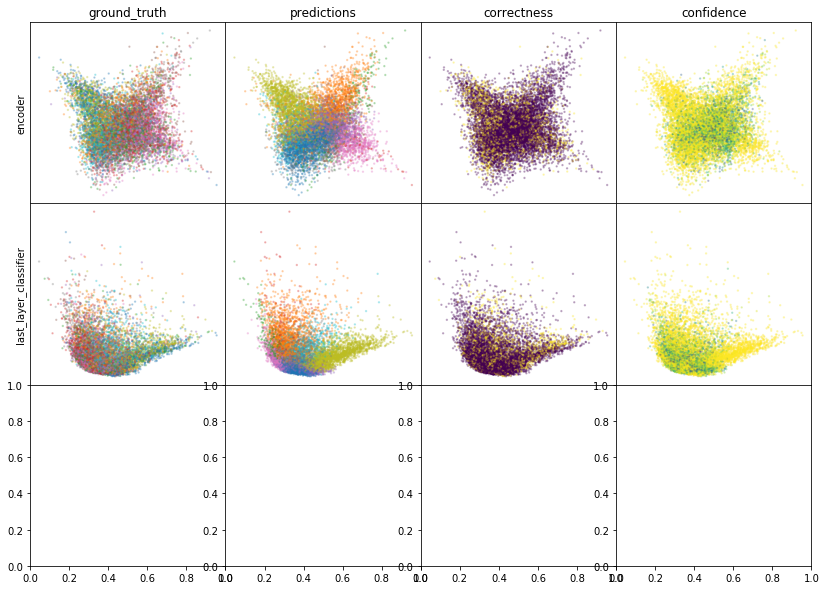

W0806 16:02:00.826850 140328764299008 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:118: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0806 16:02:00.882616 140328764299008 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:148: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0806 16:02:00.935477 140328764299008 legend.py:1282] No handles with labels found to put in legend.


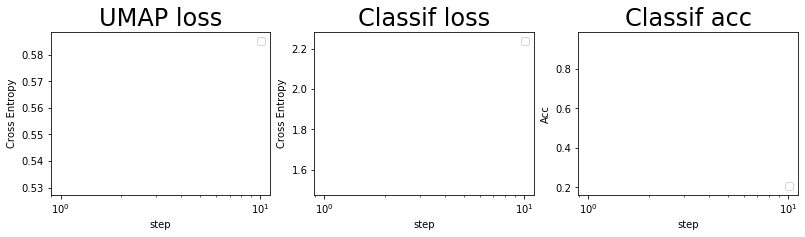

batch: 0 | train acc: 0.95 | val acc: 0.1992
saving weights | batch = 100 | acc = 23.685


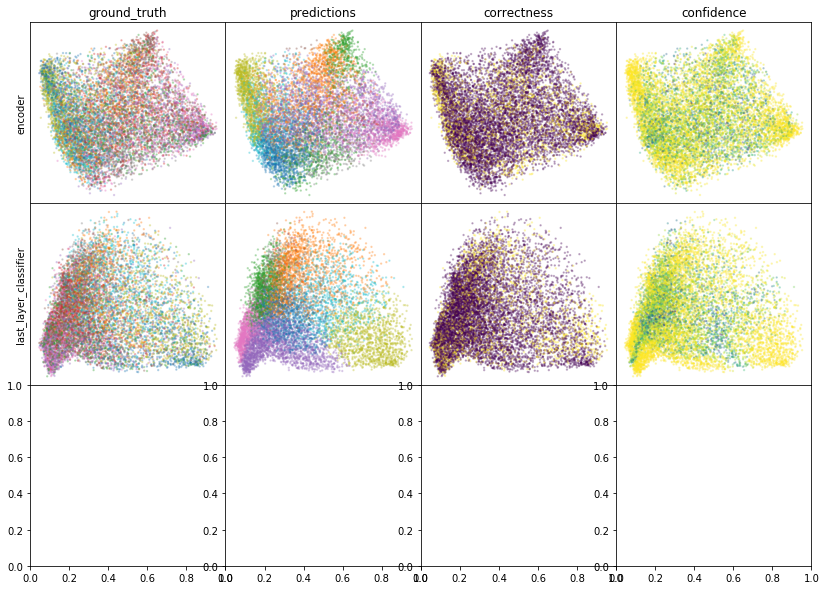

W0806 16:03:29.375705 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:03:29.433204 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:03:29.492941 140328764299008 legend.py:1282] No handles with labels found to put in legend.


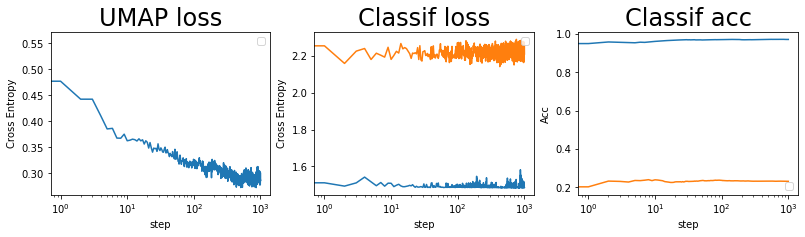

batch: 1000 | train acc: 0.9715 | val acc: 0.2319


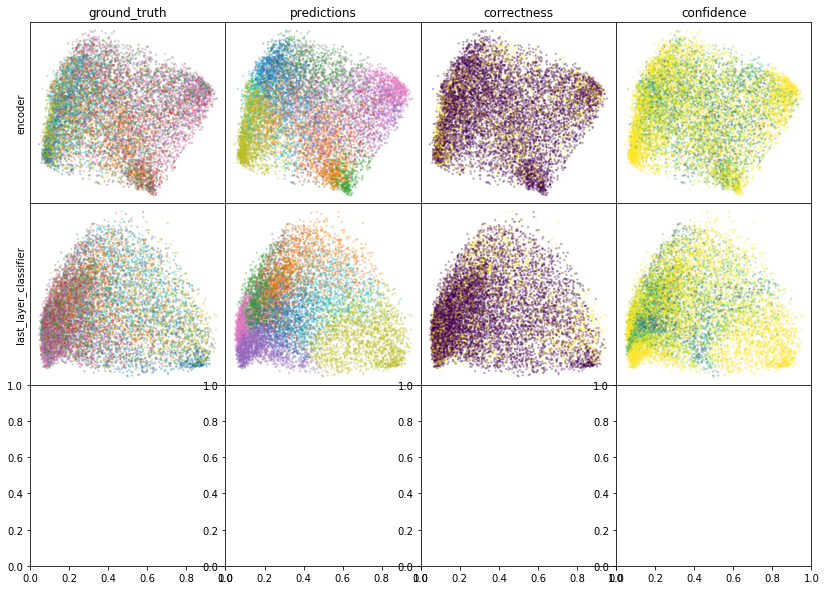

W0806 16:05:38.333503 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:05:38.393234 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:05:38.452634 140328764299008 legend.py:1282] No handles with labels found to put in legend.


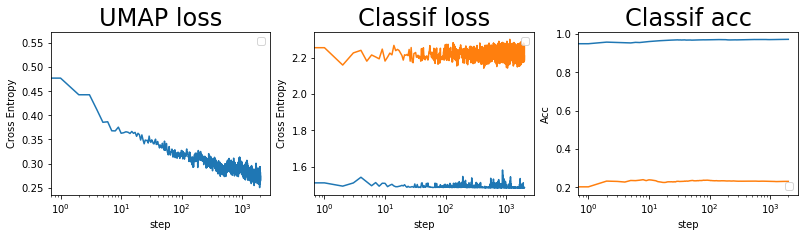

batch: 2000 | train acc: 0.9729 | val acc: 0.2316


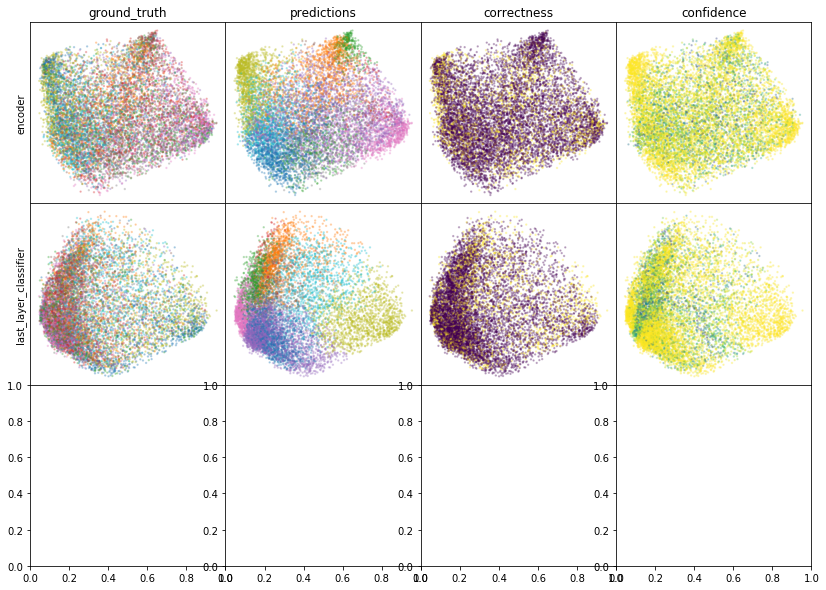

W0806 16:07:06.653070 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:07:06.719856 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:07:06.785075 140328764299008 legend.py:1282] No handles with labels found to put in legend.


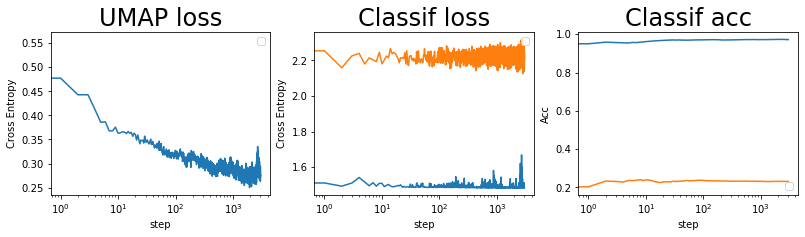

batch: 3000 | train acc: 0.9718 | val acc: 0.2313


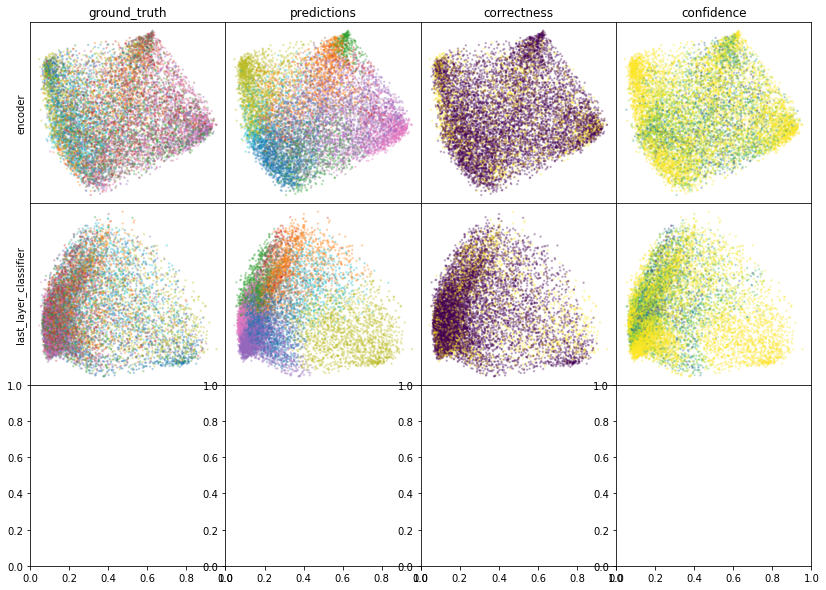

W0806 16:09:08.246810 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:09:08.312299 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:09:08.376199 140328764299008 legend.py:1282] No handles with labels found to put in legend.


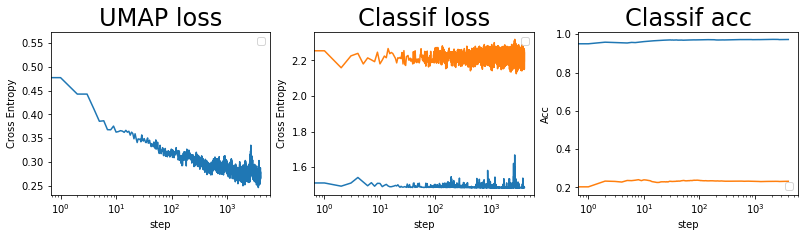

batch: 4000 | train acc: 0.9724 | val acc: 0.2322


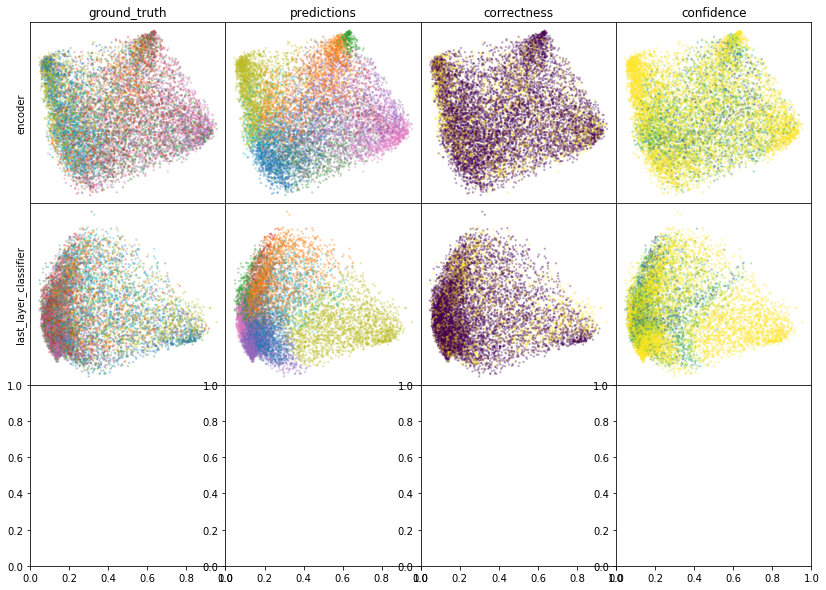

W0806 16:10:37.911510 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:10:37.981065 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:10:38.049176 140328764299008 legend.py:1282] No handles with labels found to put in legend.


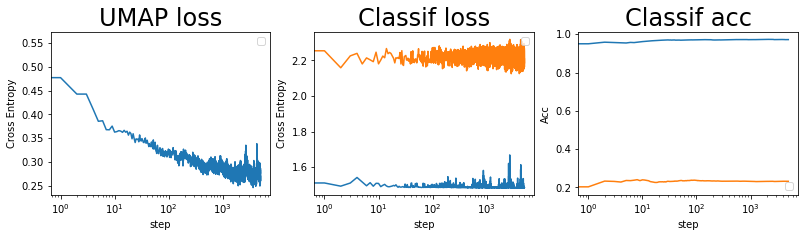

batch: 5000 | train acc: 0.9718 | val acc: 0.2321


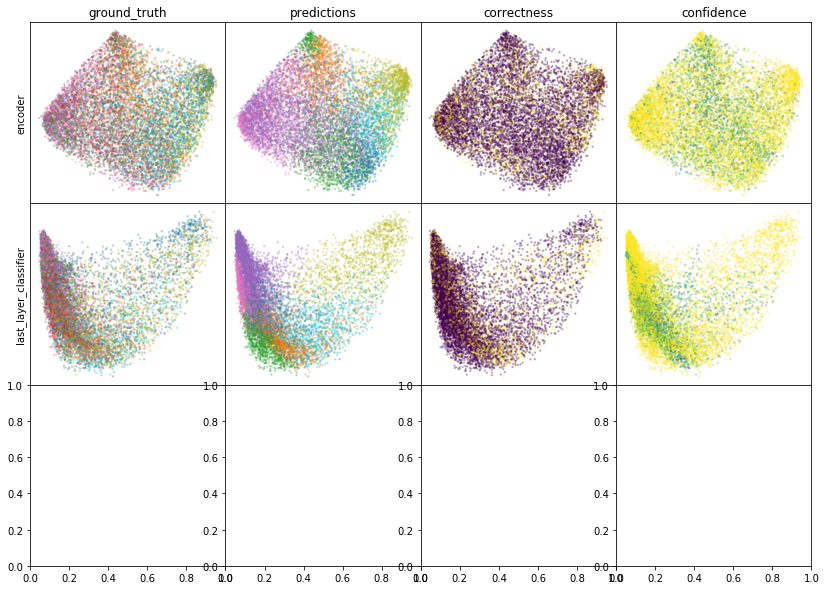

W0806 16:12:40.851367 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:12:40.923491 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:12:40.995268 140328764299008 legend.py:1282] No handles with labels found to put in legend.


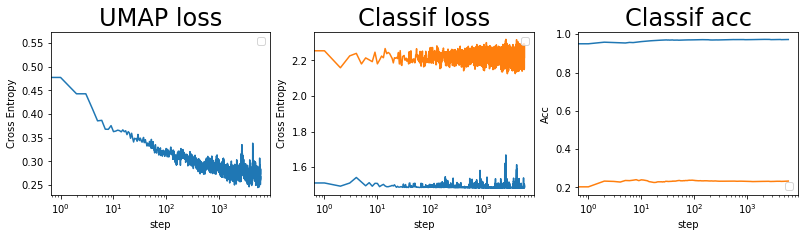

batch: 6000 | train acc: 0.9723 | val acc: 0.2333


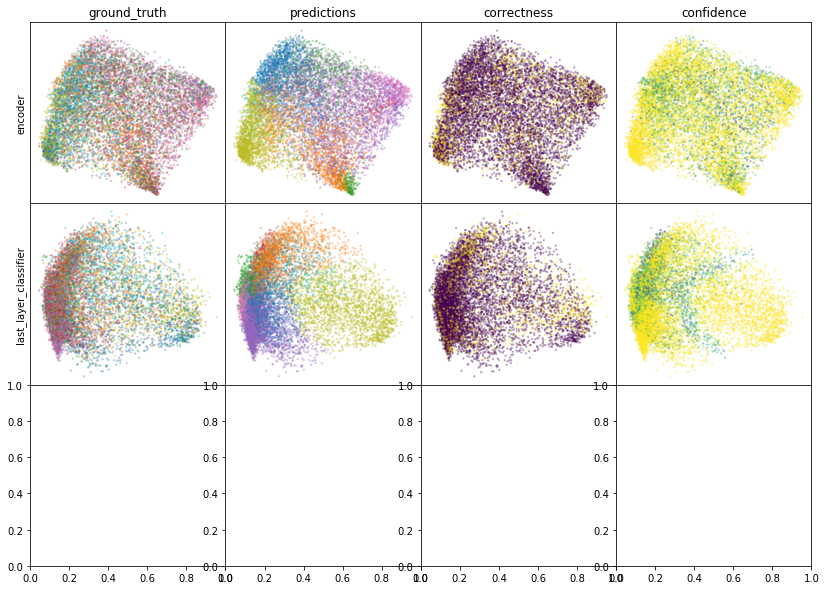

W0806 16:14:10.344078 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:14:10.416244 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:14:10.492285 140328764299008 legend.py:1282] No handles with labels found to put in legend.


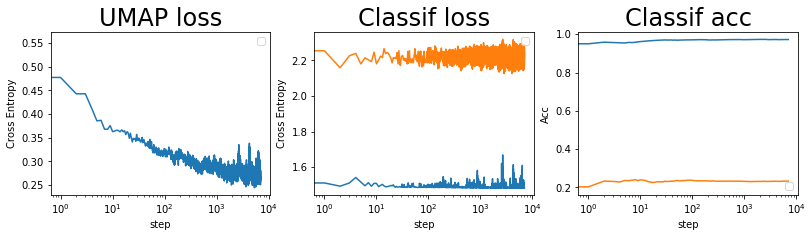

batch: 7000 | train acc: 0.9723 | val acc: 0.2334


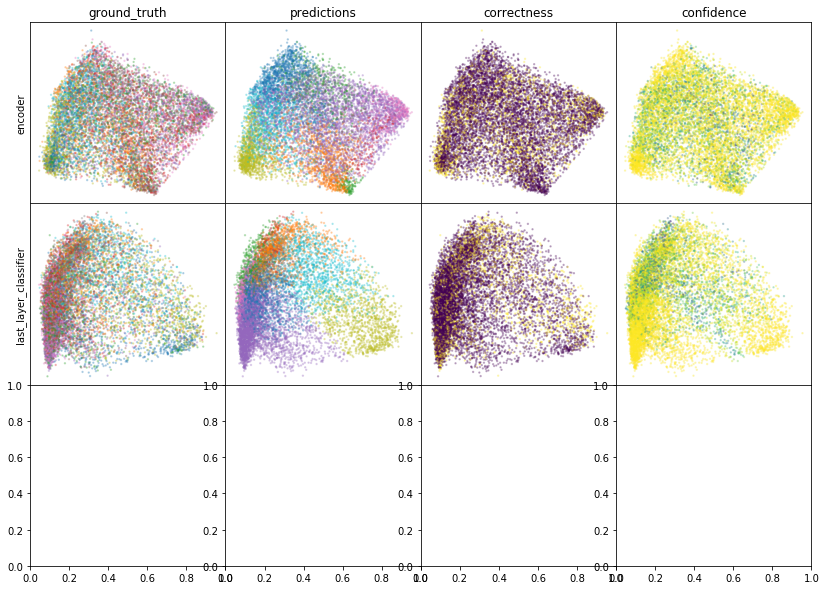

W0806 16:16:13.796649 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:16:13.874855 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:16:13.951039 140328764299008 legend.py:1282] No handles with labels found to put in legend.


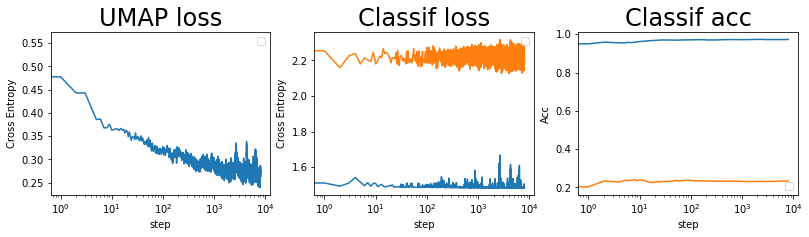

batch: 8000 | train acc: 0.9726 | val acc: 0.2339


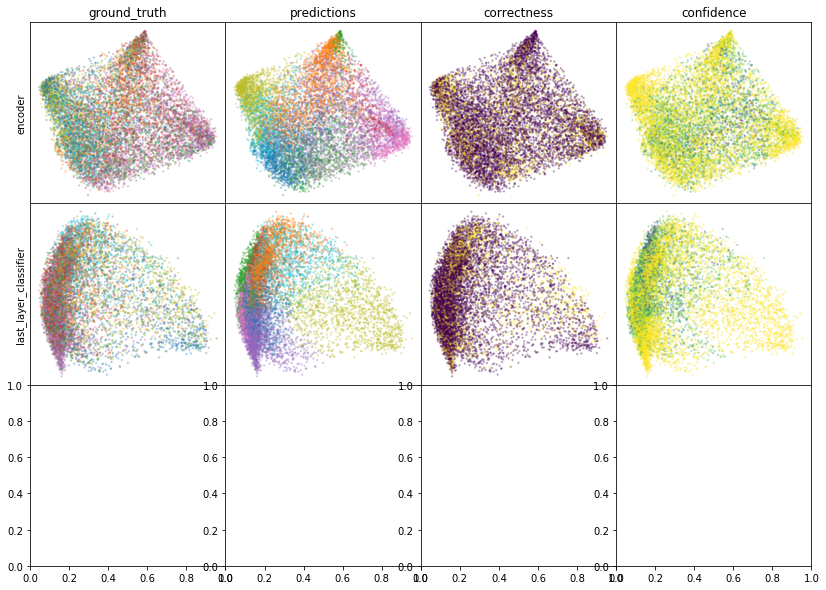

W0806 16:17:45.237807 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:17:45.318943 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:17:45.396467 140328764299008 legend.py:1282] No handles with labels found to put in legend.


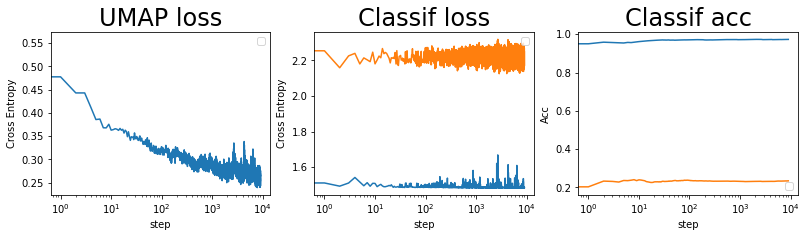

batch: 9000 | train acc: 0.9728 | val acc: 0.2344


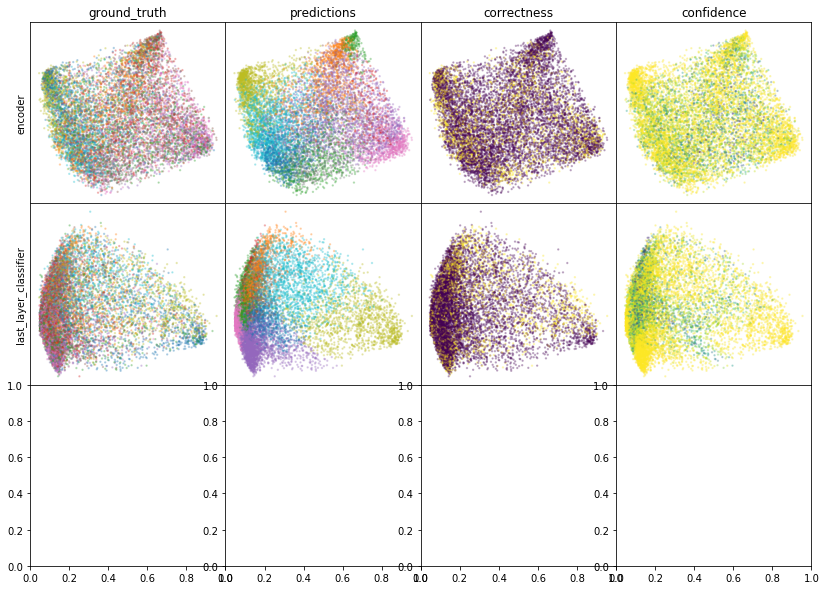

W0806 16:19:50.059120 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:19:50.140201 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:19:50.219953 140328764299008 legend.py:1282] No handles with labels found to put in legend.


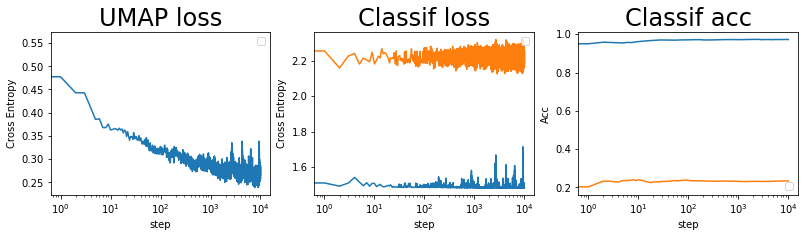

batch: 10000 | train acc: 0.9721 | val acc: 0.2341
leaving epoch because no improvement in 10000 batches


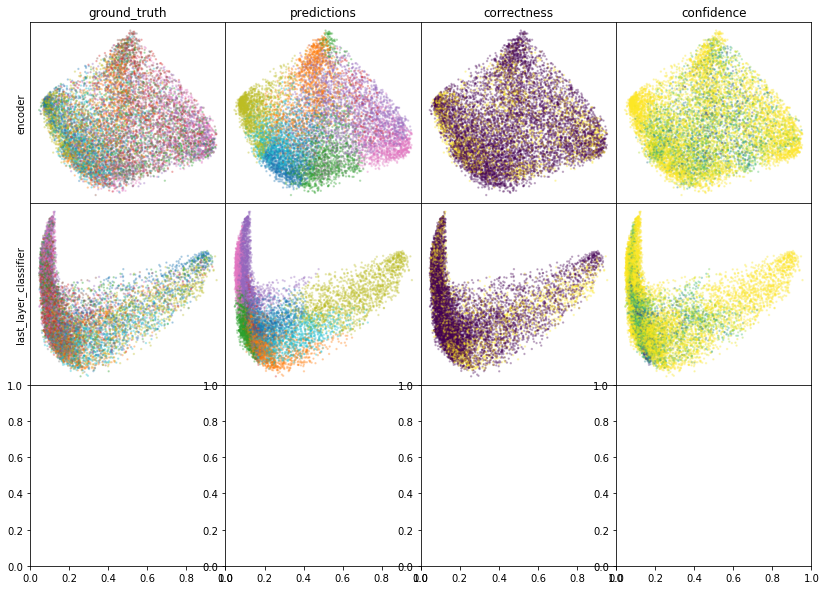

W0806 16:22:12.696649 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:22:12.780493 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:22:12.862109 140328764299008 legend.py:1282] No handles with labels found to put in legend.


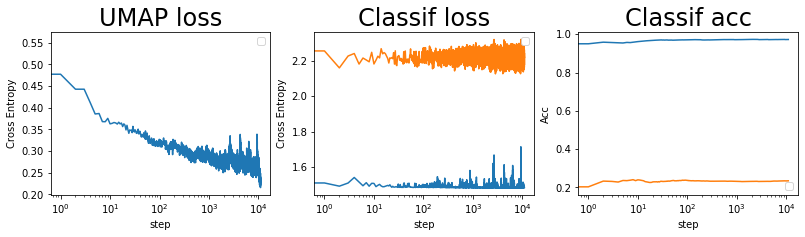

batch: 11000 | train acc: 0.9723 | val acc: 0.2346


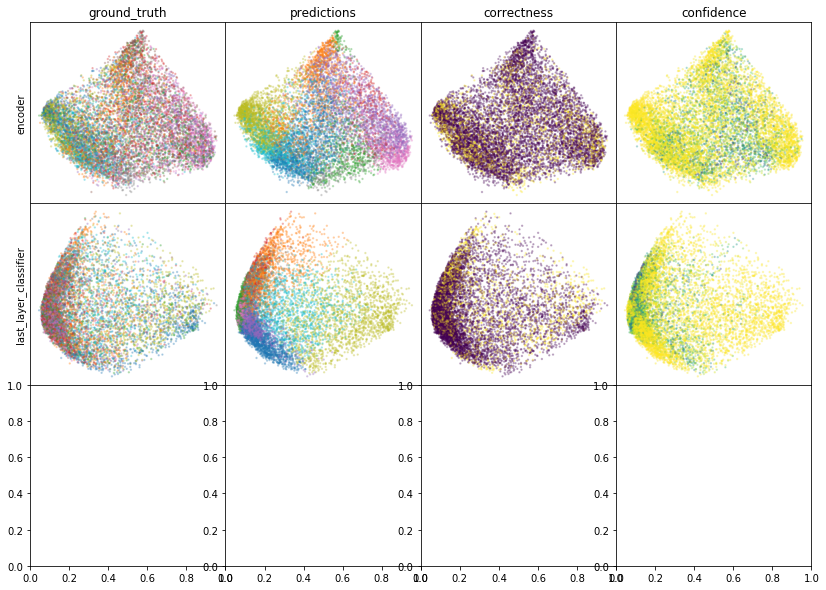

W0806 16:23:45.428046 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:23:45.515420 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:23:45.603193 140328764299008 legend.py:1282] No handles with labels found to put in legend.


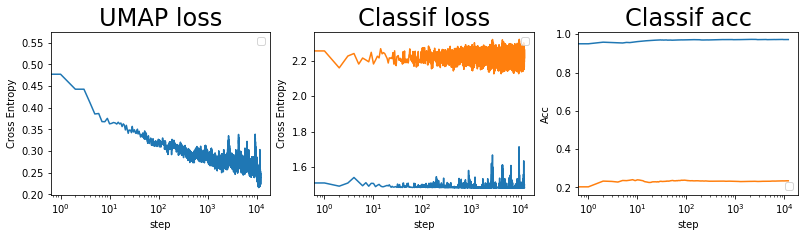

batch: 12000 | train acc: 0.9721 | val acc: 0.2346


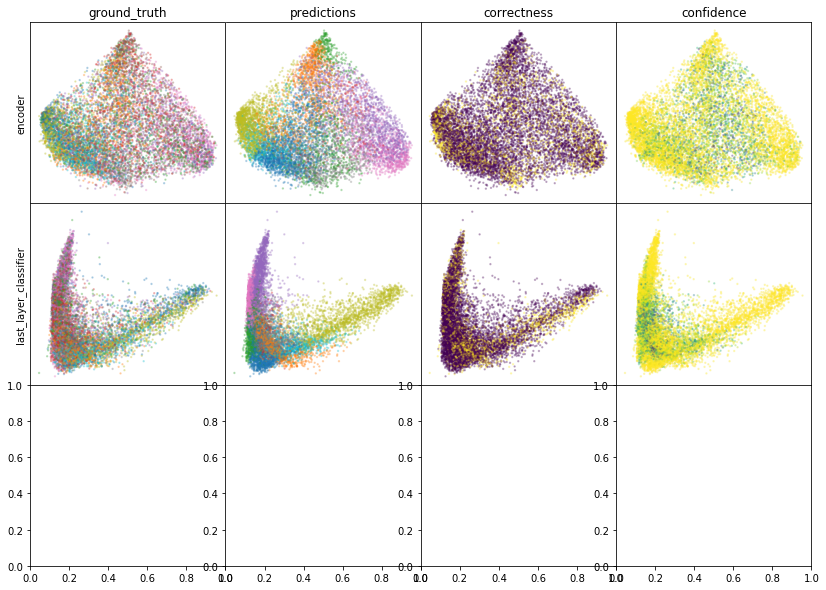

W0806 16:25:51.435570 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:25:51.527743 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:25:51.617948 140328764299008 legend.py:1282] No handles with labels found to put in legend.


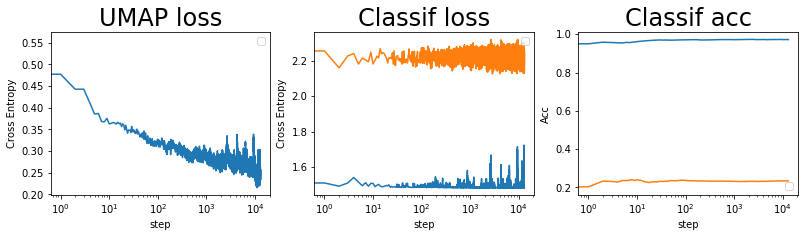

batch: 13000 | train acc: 0.9718 | val acc: 0.2347


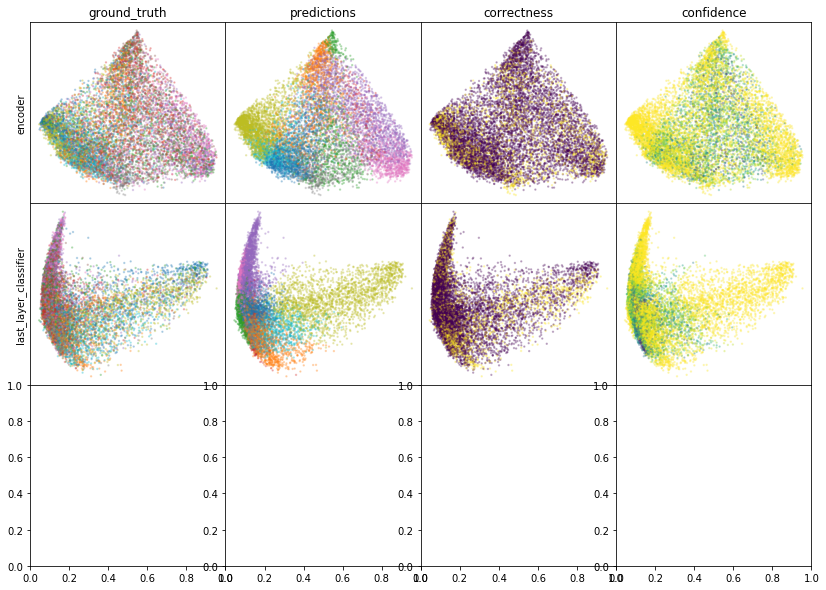

W0806 16:27:24.356057 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:27:24.448355 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:27:24.540505 140328764299008 legend.py:1282] No handles with labels found to put in legend.


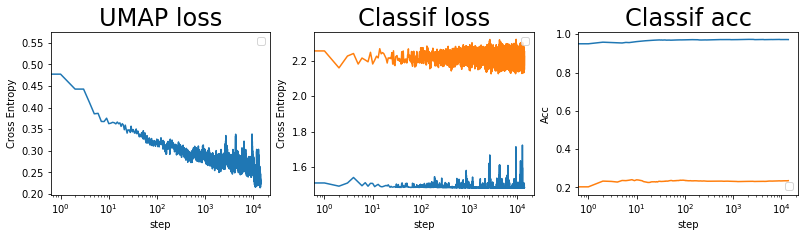

batch: 14000 | train acc: 0.972 | val acc: 0.2353


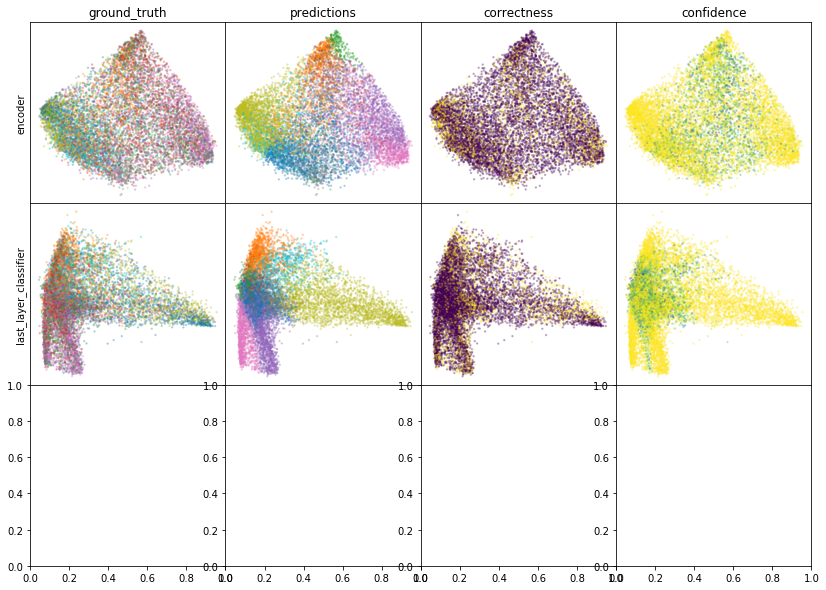

W0806 16:29:31.827831 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:29:31.926485 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:29:32.026777 140328764299008 legend.py:1282] No handles with labels found to put in legend.


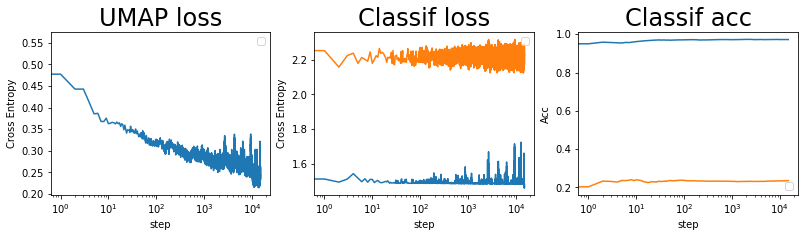

batch: 15000 | train acc: 0.972 | val acc: 0.2354


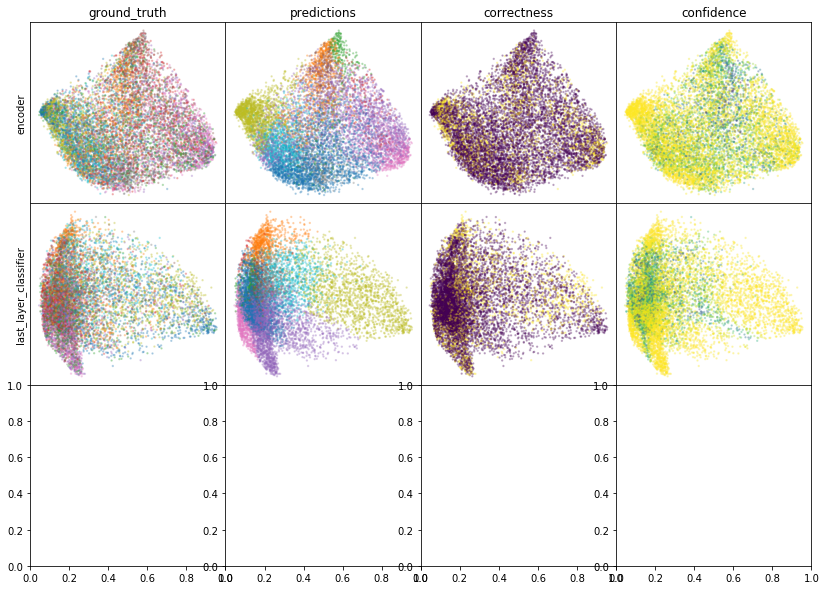

W0806 16:31:39.416801 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:31:39.513670 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:31:39.609307 140328764299008 legend.py:1282] No handles with labels found to put in legend.


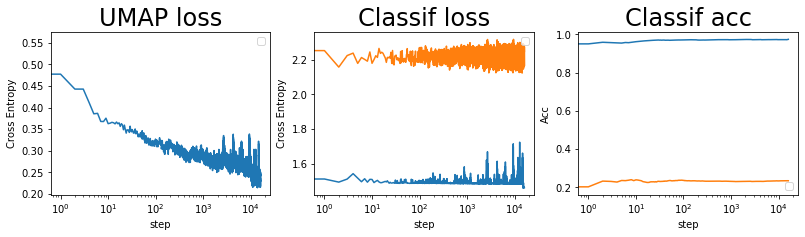

batch: 16000 | train acc: 0.9737 | val acc: 0.235


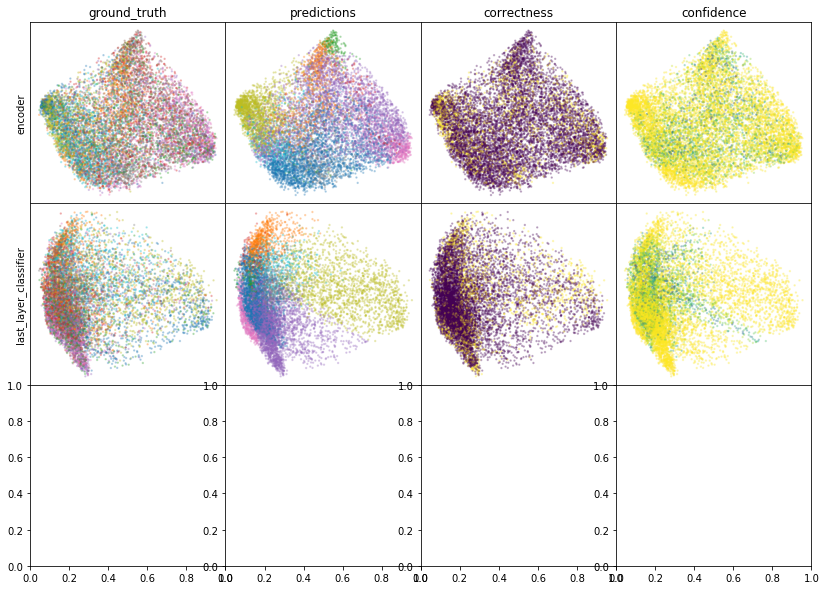

W0806 16:33:13.908642 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:33:14.009310 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:33:14.107640 140328764299008 legend.py:1282] No handles with labels found to put in legend.


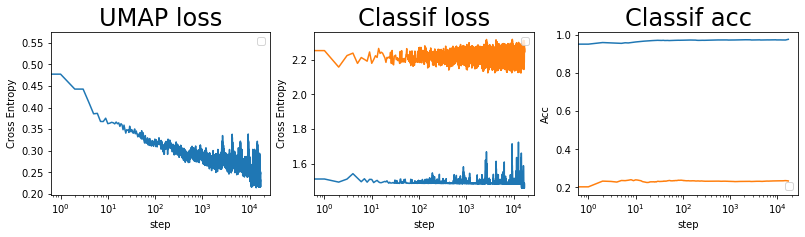

batch: 17000 | train acc: 0.9752 | val acc: 0.2339


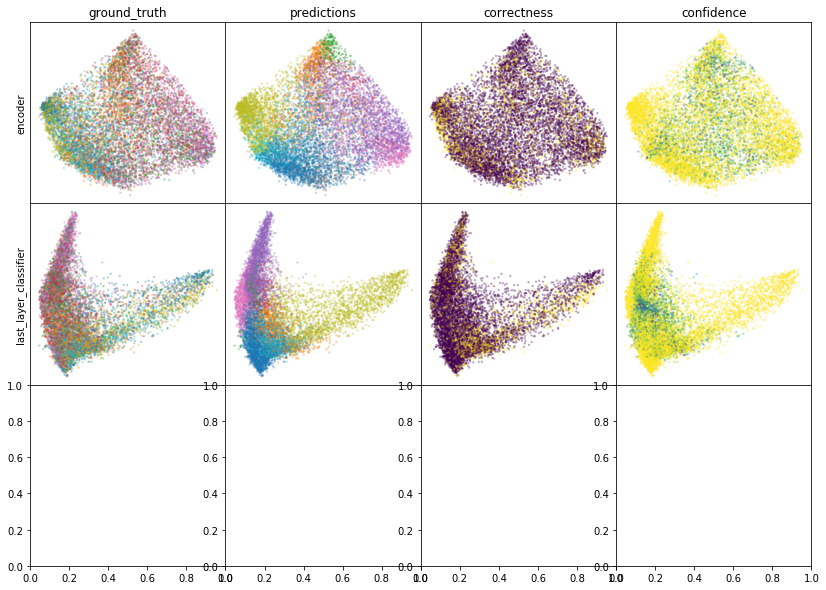

W0806 16:35:22.523253 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:35:22.628012 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:35:22.729536 140328764299008 legend.py:1282] No handles with labels found to put in legend.


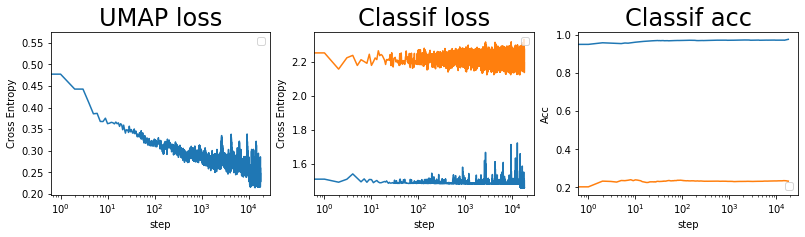

batch: 18000 | train acc: 0.9764 | val acc: 0.233


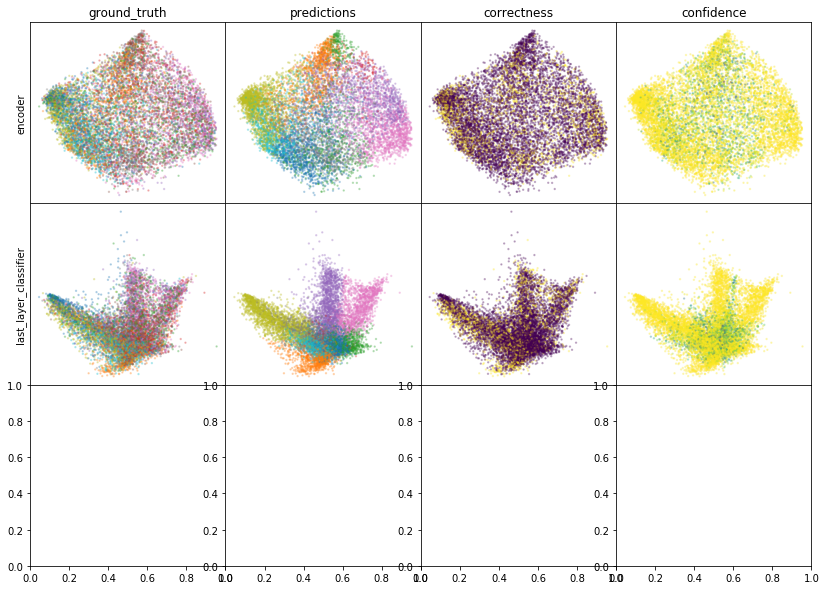

W0806 16:36:57.746514 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:36:57.852318 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:36:57.961988 140328764299008 legend.py:1282] No handles with labels found to put in legend.


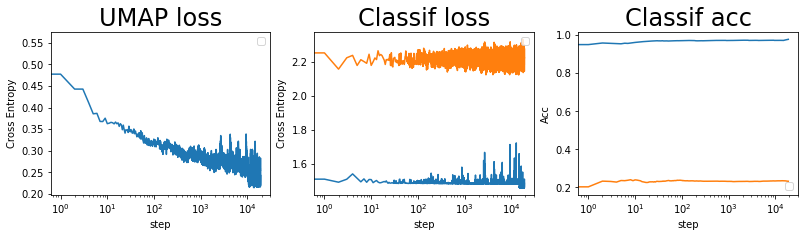

batch: 19000 | train acc: 0.9776 | val acc: 0.2326


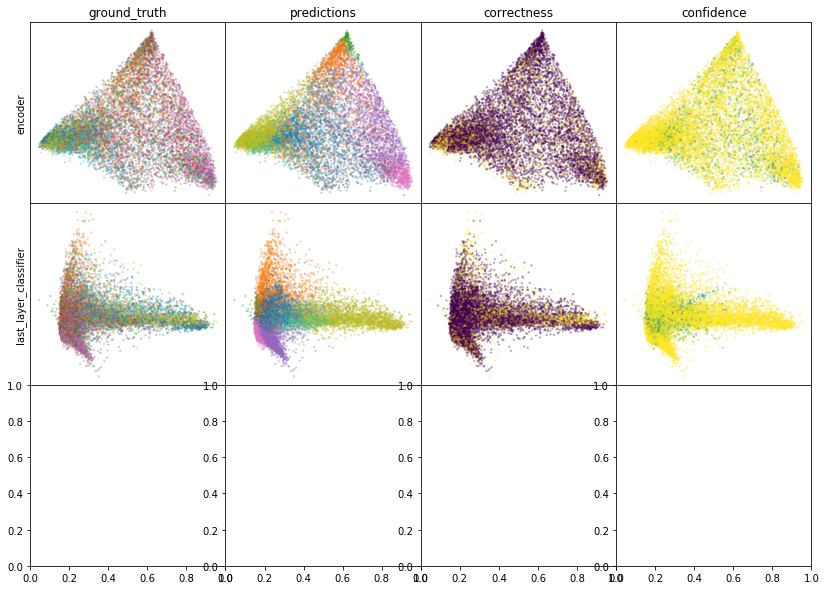

W0806 16:39:07.161210 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:39:07.275440 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:39:07.382431 140328764299008 legend.py:1282] No handles with labels found to put in legend.


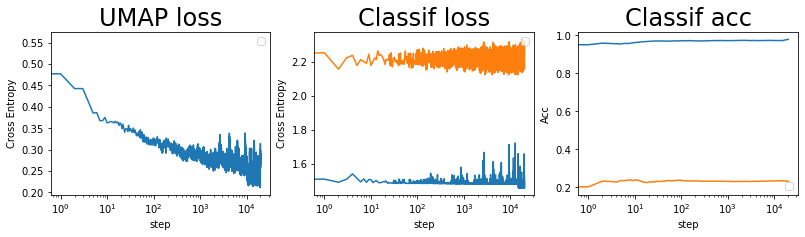

batch: 20000 | train acc: 0.9783 | val acc: 0.2324
leaving epoch because no improvement in 10000 batches


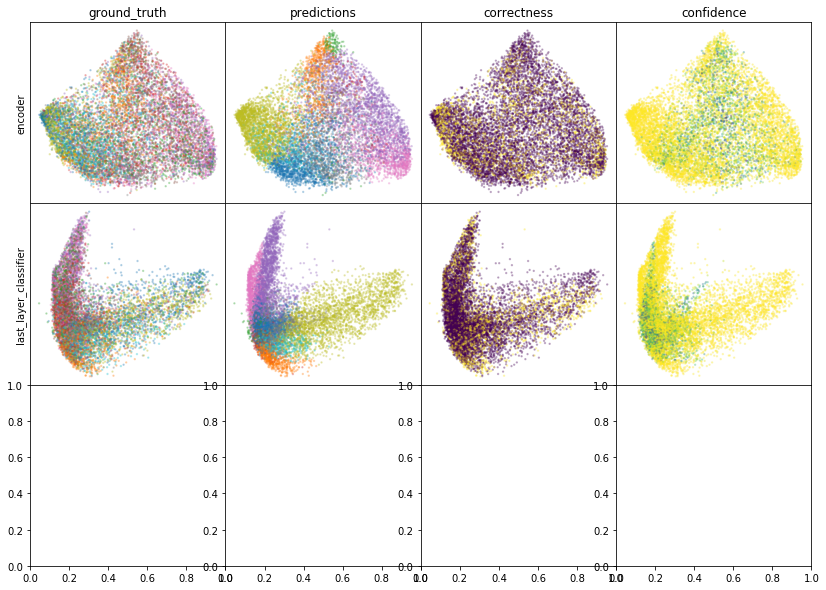

W0806 16:41:34.526847 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:41:34.638288 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:41:34.750473 140328764299008 legend.py:1282] No handles with labels found to put in legend.


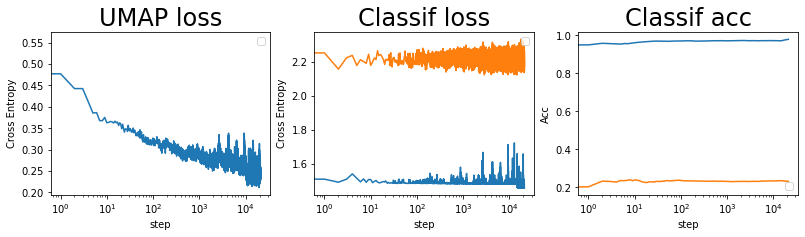

batch: 21000 | train acc: 0.9792 | val acc: 0.2326


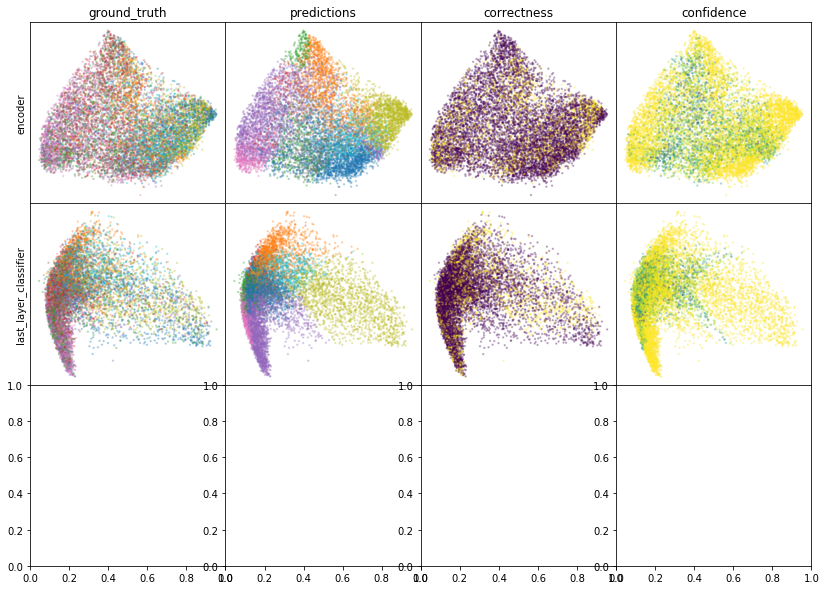

W0806 16:43:11.038193 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:43:11.151245 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:43:11.265134 140328764299008 legend.py:1282] No handles with labels found to put in legend.


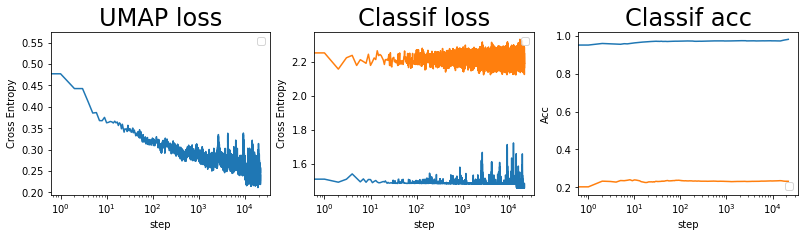

batch: 22000 | train acc: 0.9801 | val acc: 0.2324


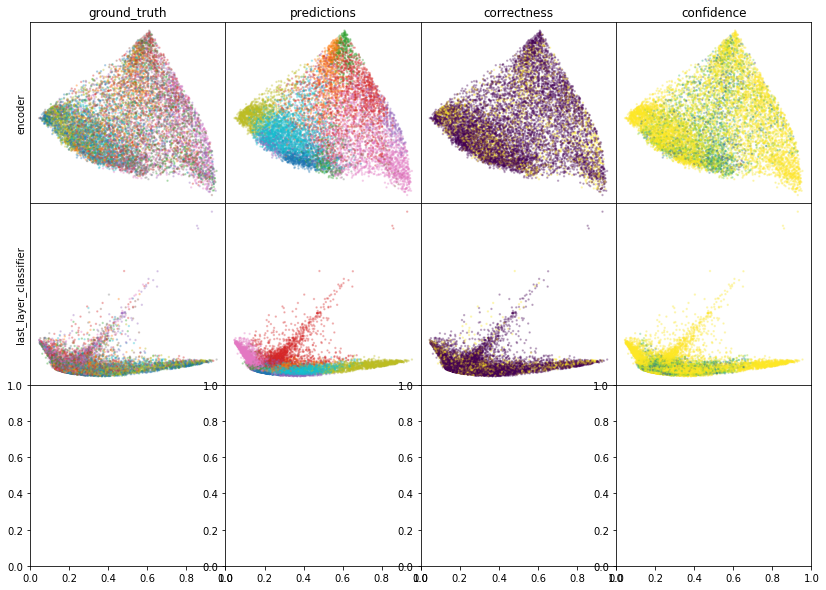

W0806 16:45:20.534929 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:45:20.648869 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:45:20.761849 140328764299008 legend.py:1282] No handles with labels found to put in legend.


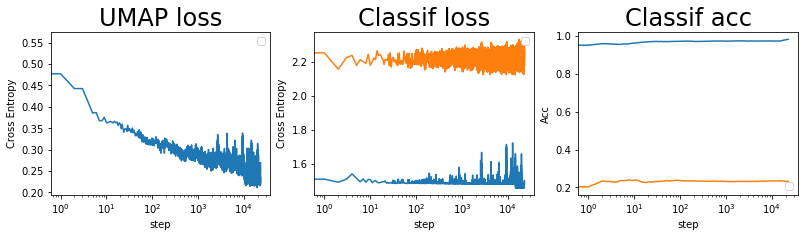

batch: 23000 | train acc: 0.981 | val acc: 0.2323


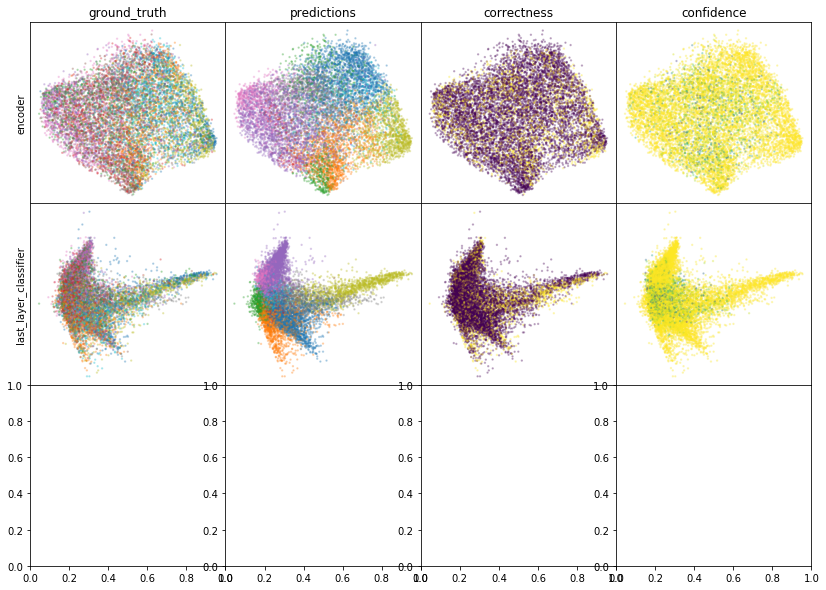

W0806 16:46:57.929638 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:46:58.048863 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:46:58.169079 140328764299008 legend.py:1282] No handles with labels found to put in legend.


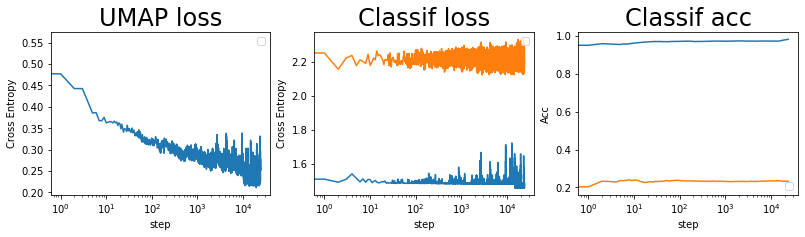

batch: 24000 | train acc: 0.9813 | val acc: 0.2323


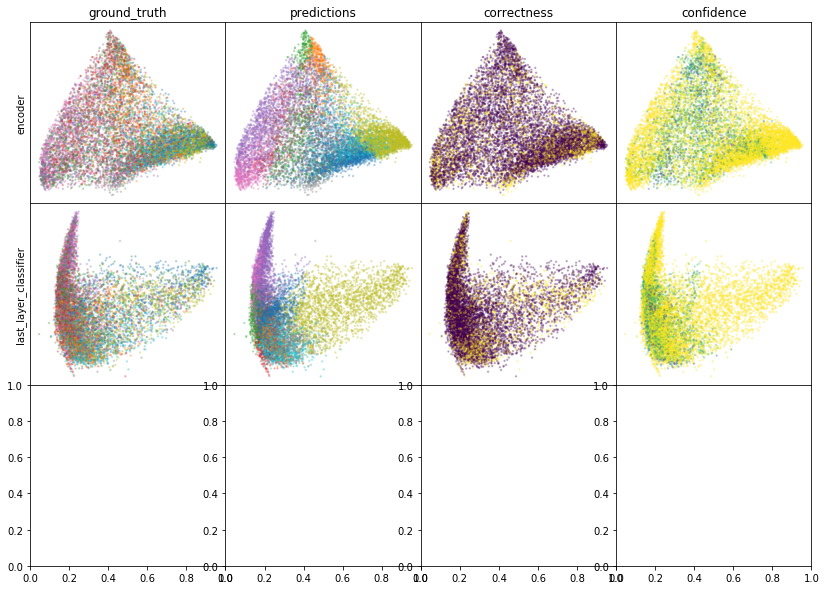

W0806 16:49:09.606293 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:49:09.729214 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:49:09.849970 140328764299008 legend.py:1282] No handles with labels found to put in legend.


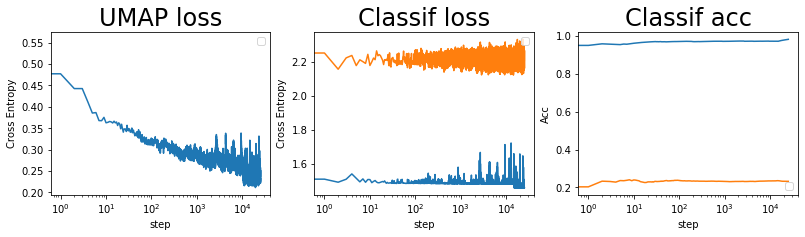

batch: 25000 | train acc: 0.982 | val acc: 0.2323


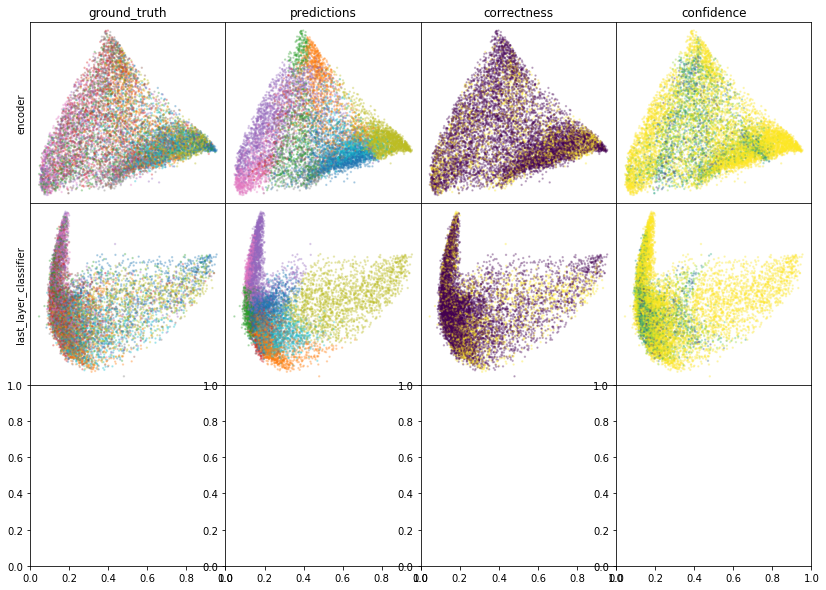

W0806 16:50:48.398251 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:50:48.528841 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:50:48.657032 140328764299008 legend.py:1282] No handles with labels found to put in legend.


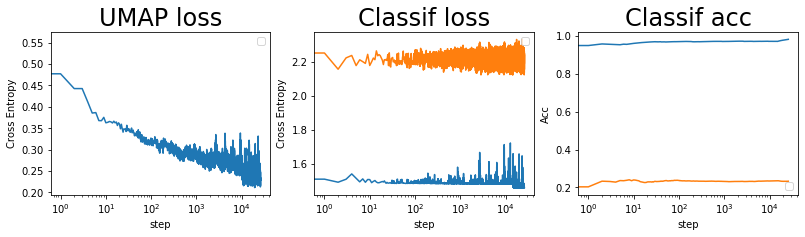

batch: 26000 | train acc: 0.9827 | val acc: 0.2329


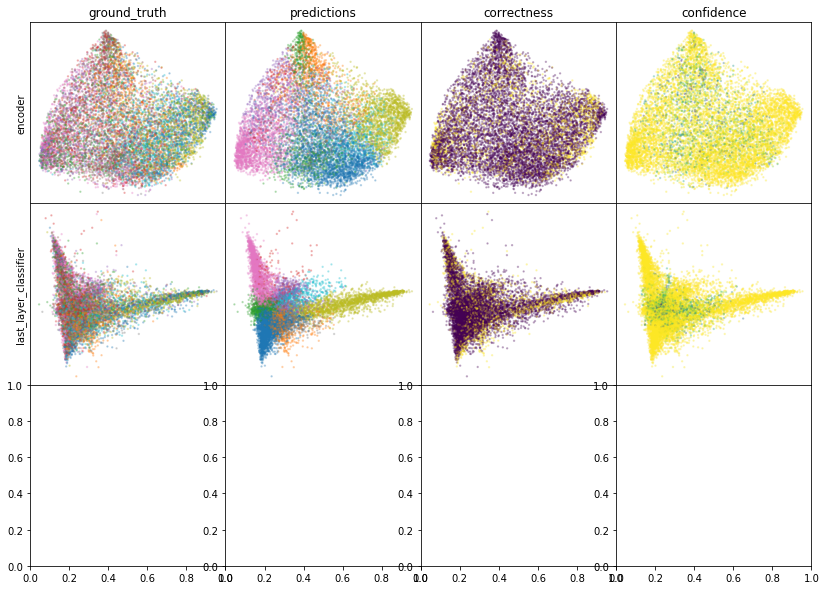

W0806 16:53:00.101909 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:53:00.242470 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:53:00.372875 140328764299008 legend.py:1282] No handles with labels found to put in legend.


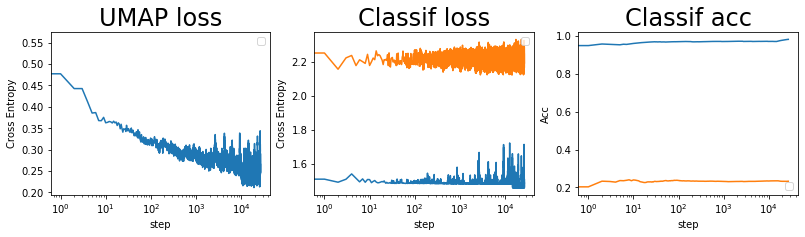

batch: 27000 | train acc: 0.9828 | val acc: 0.2328


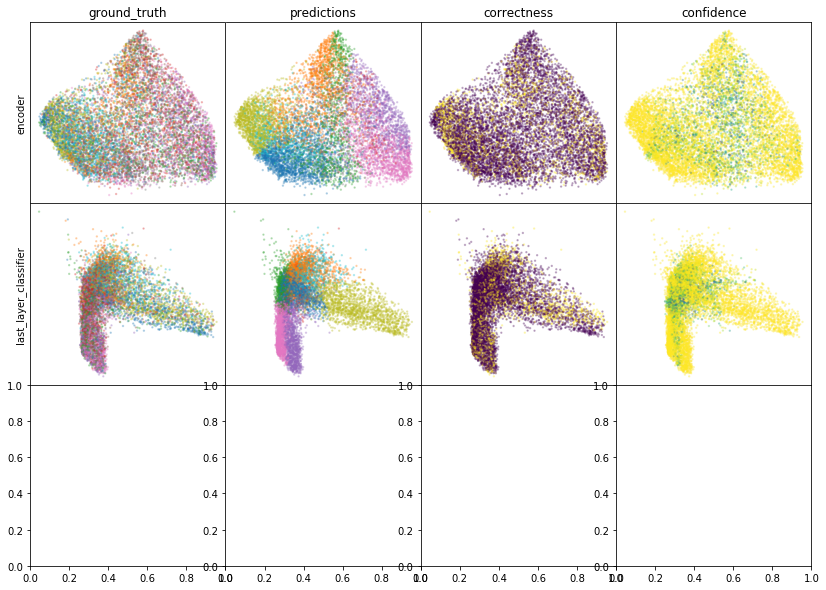

W0806 16:54:38.634110 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:54:38.768619 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:54:38.898875 140328764299008 legend.py:1282] No handles with labels found to put in legend.


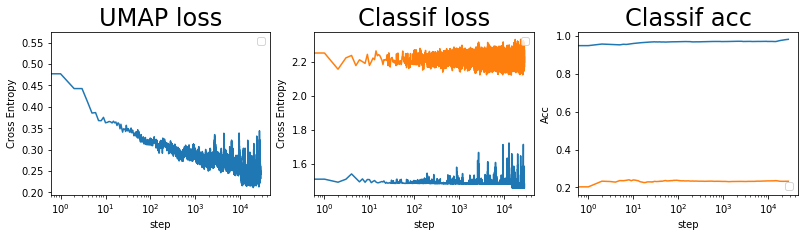

batch: 28000 | train acc: 0.9833 | val acc: 0.2327


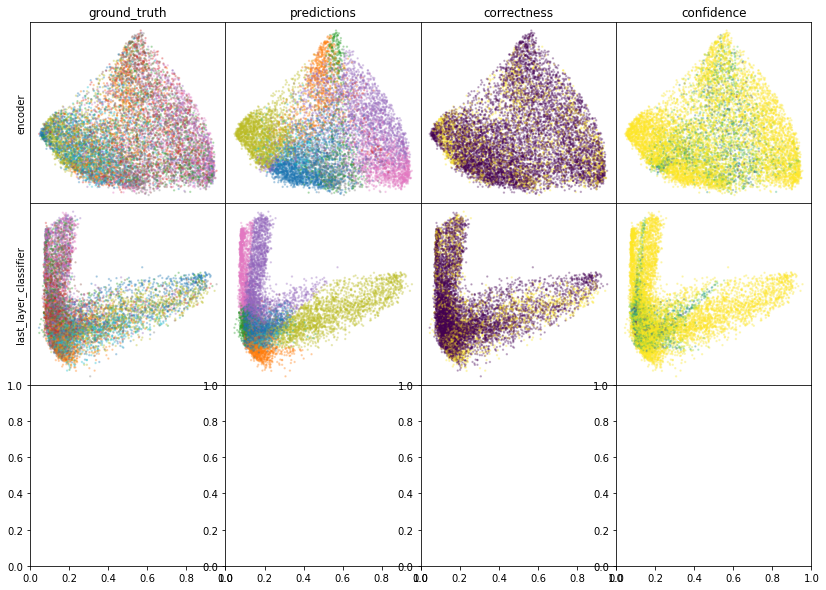

W0806 16:56:52.321757 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:56:52.461433 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:56:52.599140 140328764299008 legend.py:1282] No handles with labels found to put in legend.


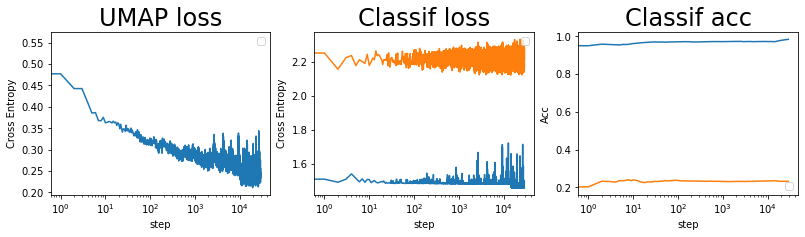

batch: 29000 | train acc: 0.9839 | val acc: 0.2328


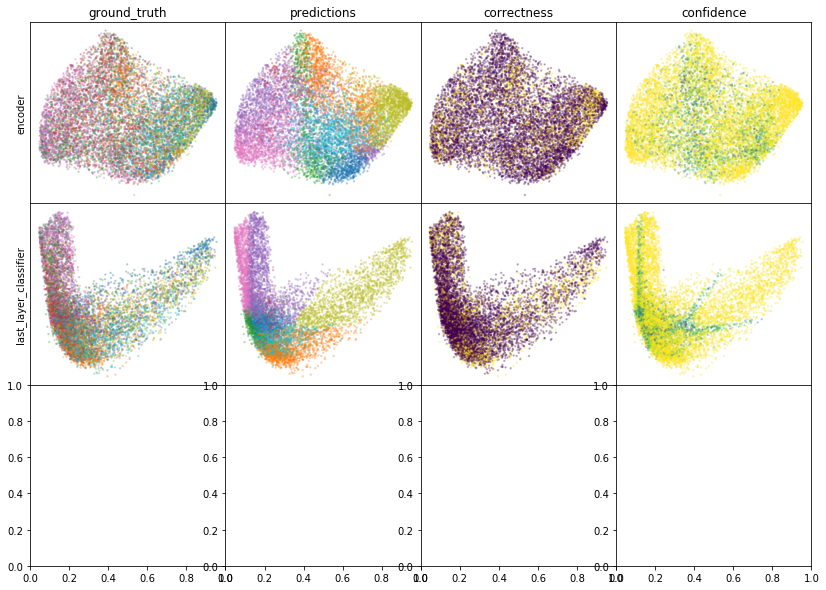

W0806 16:59:06.801512 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:59:06.941007 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 16:59:07.084640 140328764299008 legend.py:1282] No handles with labels found to put in legend.


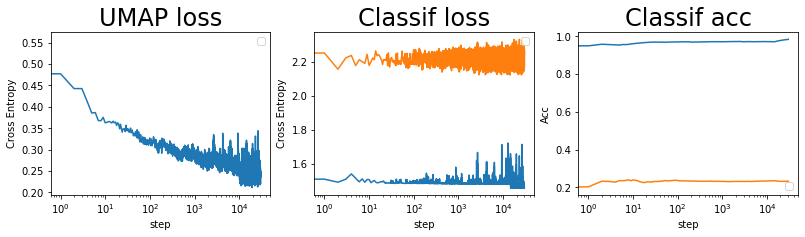

batch: 30000 | train acc: 0.9844 | val acc: 0.2328
leaving epoch because no improvement in 10000 batches


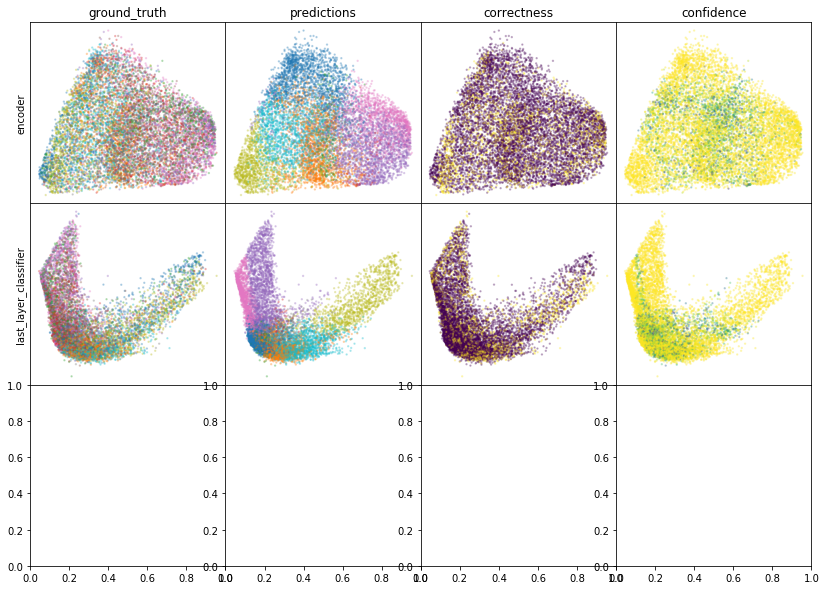

W0806 17:01:38.349162 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:01:38.494668 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:01:38.640785 140328764299008 legend.py:1282] No handles with labels found to put in legend.


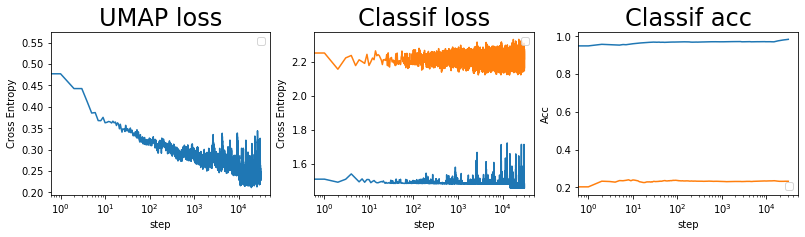

batch: 31000 | train acc: 0.9848 | val acc: 0.2327


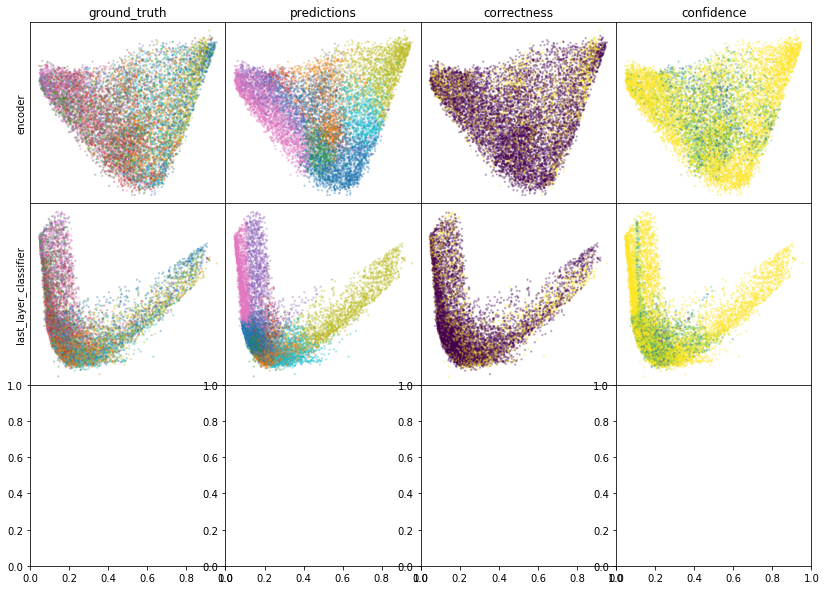

W0806 17:03:19.234668 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:03:19.373799 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:03:19.519068 140328764299008 legend.py:1282] No handles with labels found to put in legend.


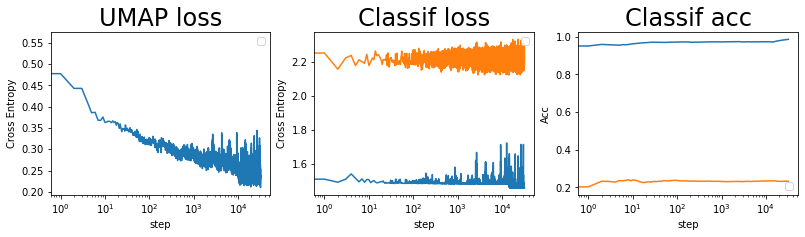

batch: 32000 | train acc: 0.9852 | val acc: 0.2326


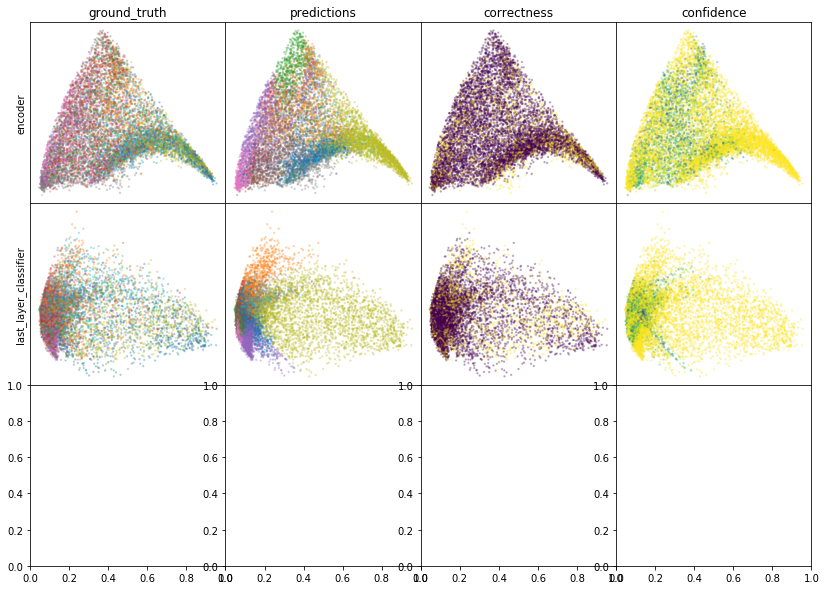

W0806 17:05:33.328012 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:05:33.474044 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:05:33.616560 140328764299008 legend.py:1282] No handles with labels found to put in legend.


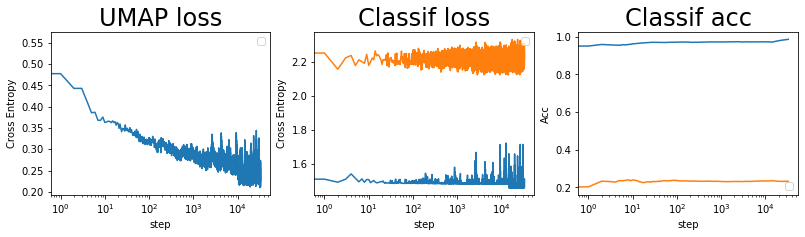

batch: 33000 | train acc: 0.9857 | val acc: 0.2324


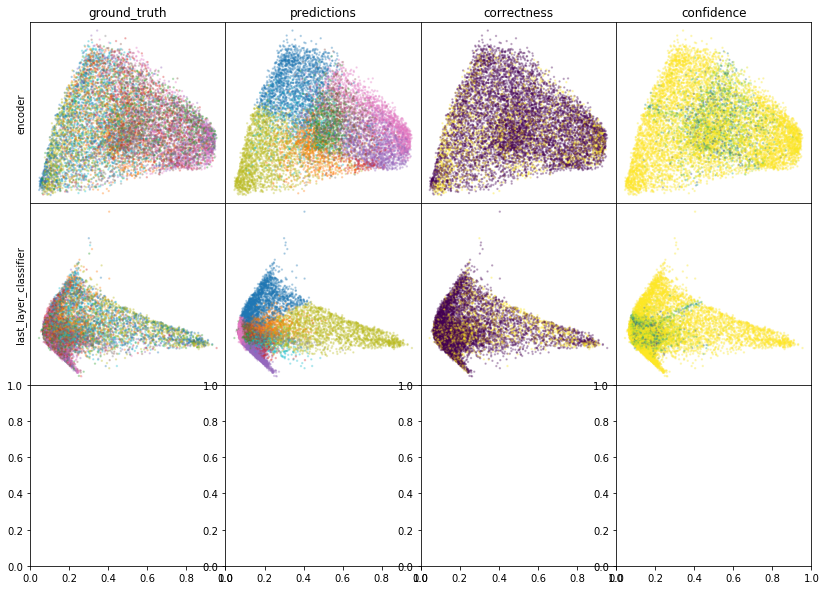

W0806 17:07:15.244236 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:07:15.394251 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:07:15.539802 140328764299008 legend.py:1282] No handles with labels found to put in legend.


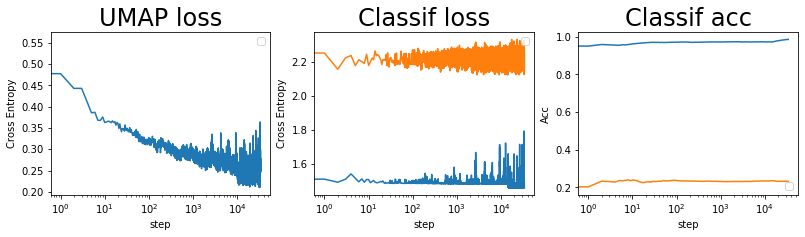

batch: 34000 | train acc: 0.9851 | val acc: 0.2321


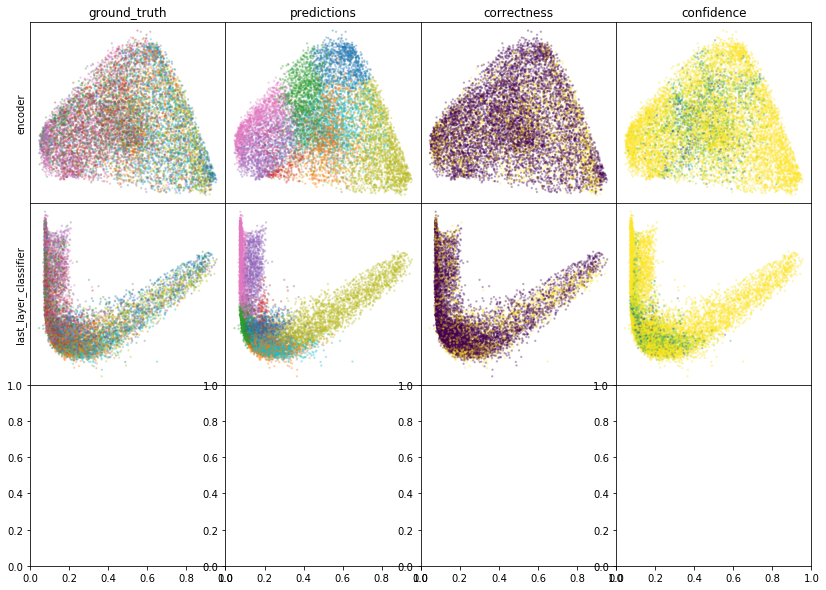

W0806 17:09:30.695329 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:09:30.844478 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:09:30.994400 140328764299008 legend.py:1282] No handles with labels found to put in legend.


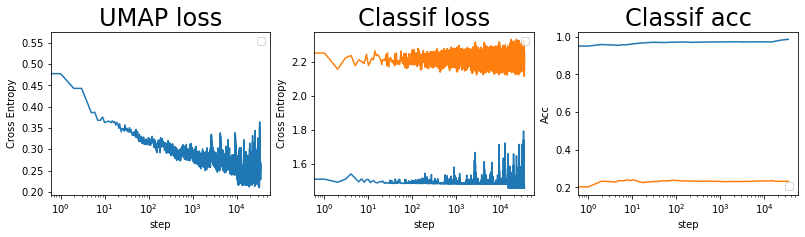

batch: 35000 | train acc: 0.9855 | val acc: 0.2324


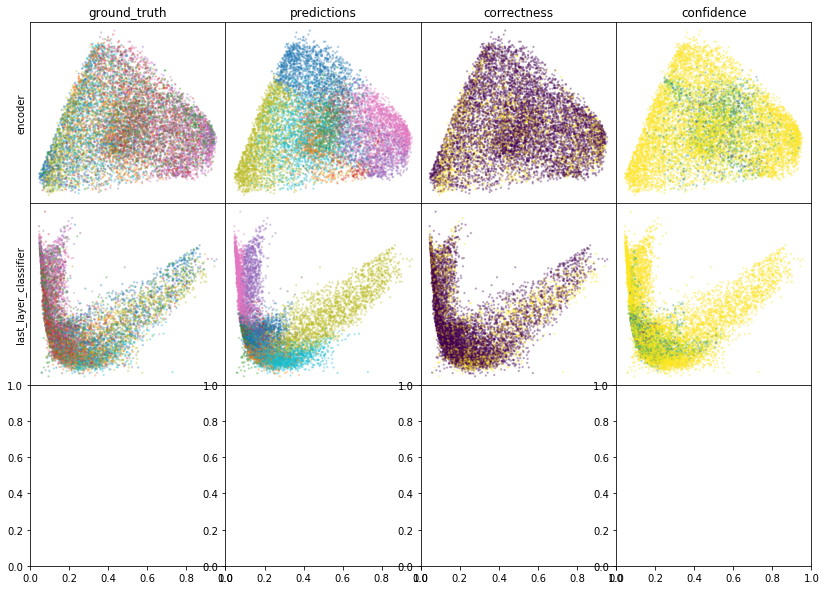

W0806 17:11:14.377237 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:11:14.533166 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:11:14.687373 140328764299008 legend.py:1282] No handles with labels found to put in legend.


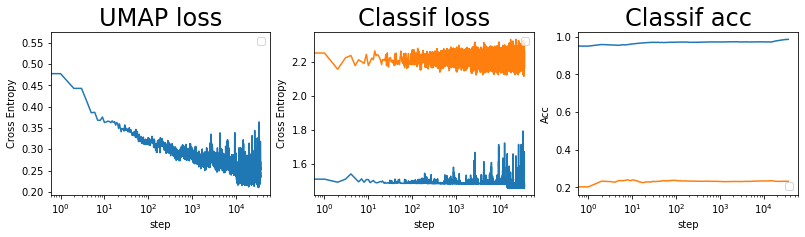

batch: 36000 | train acc: 0.9858 | val acc: 0.2325


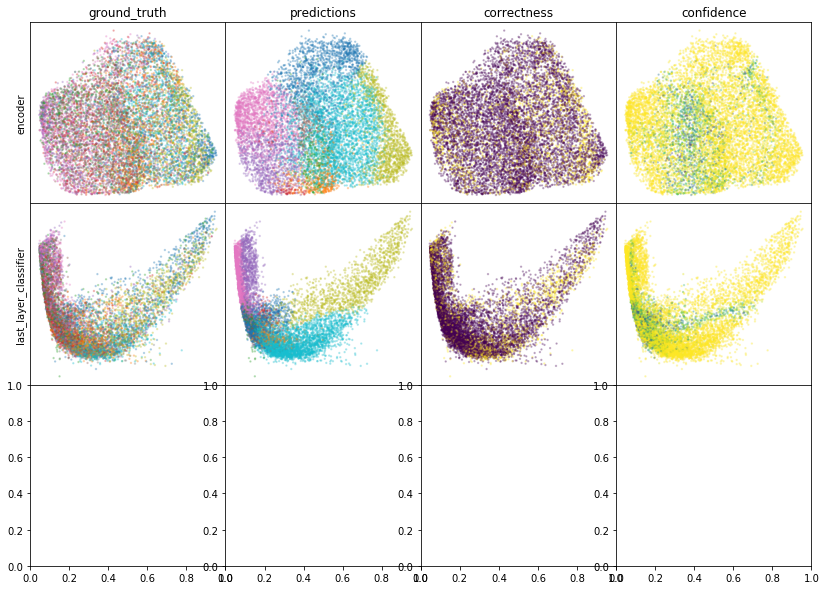

W0806 17:13:31.086885 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:13:31.242604 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:13:31.412754 140328764299008 legend.py:1282] No handles with labels found to put in legend.


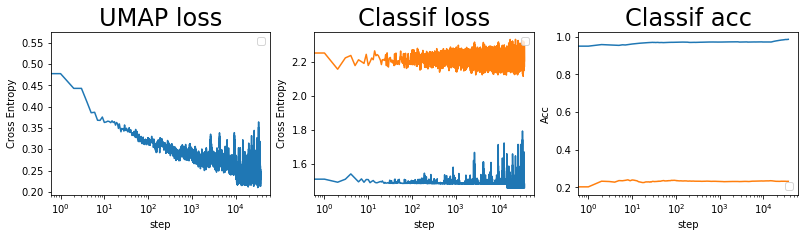

batch: 37000 | train acc: 0.9862 | val acc: 0.2325


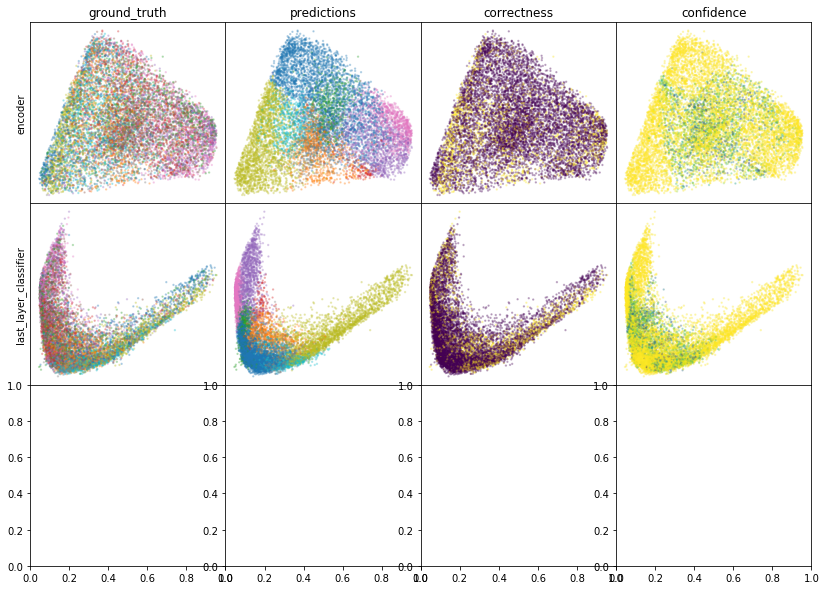

W0806 17:15:14.639640 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:15:14.796380 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:15:14.959947 140328764299008 legend.py:1282] No handles with labels found to put in legend.


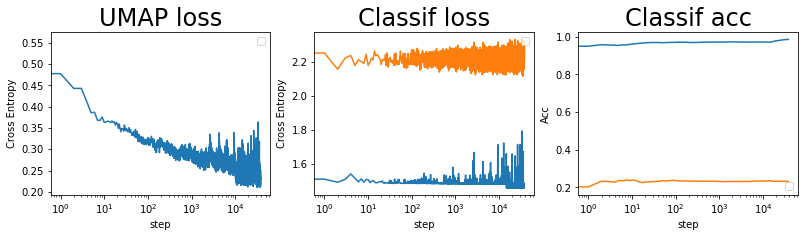

batch: 38000 | train acc: 0.9866 | val acc: 0.2321


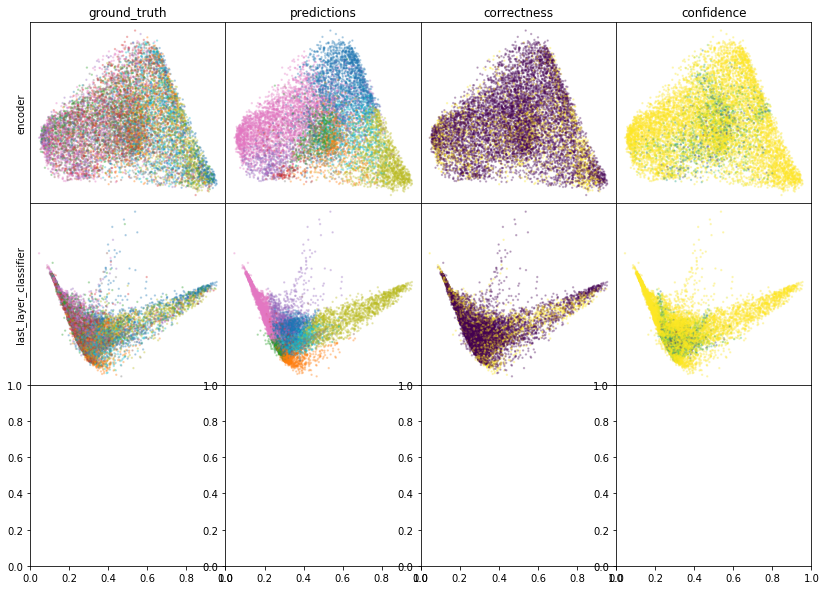

W0806 17:17:31.341856 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:17:31.509893 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:17:31.669070 140328764299008 legend.py:1282] No handles with labels found to put in legend.


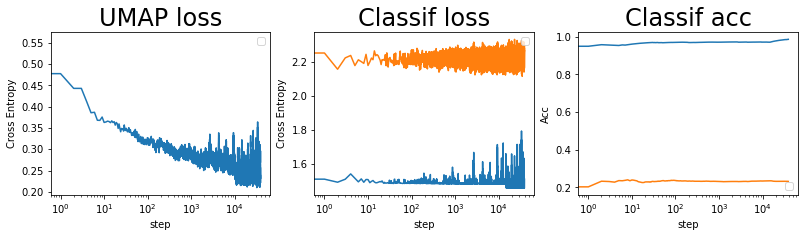

batch: 39000 | train acc: 0.9868 | val acc: 0.2321


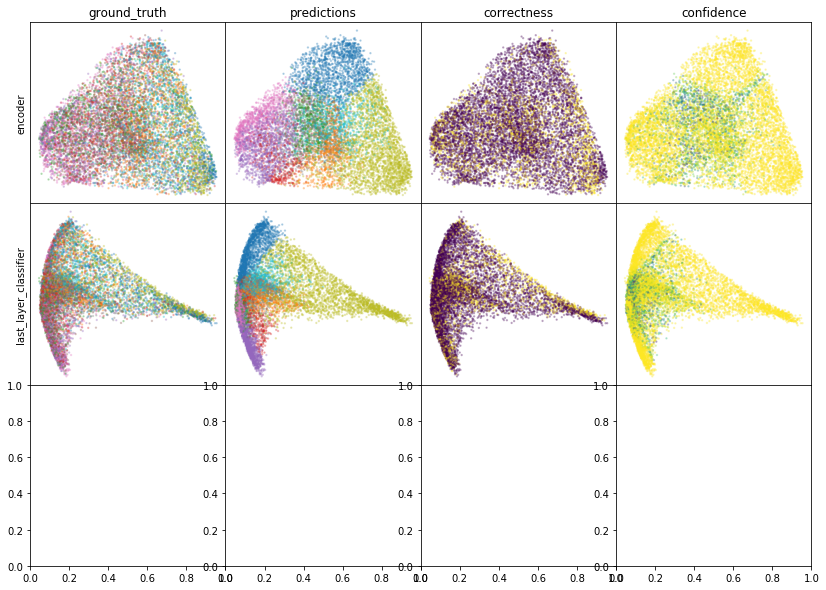

W0806 17:19:15.632836 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:19:15.812783 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:19:16.001628 140328764299008 legend.py:1282] No handles with labels found to put in legend.


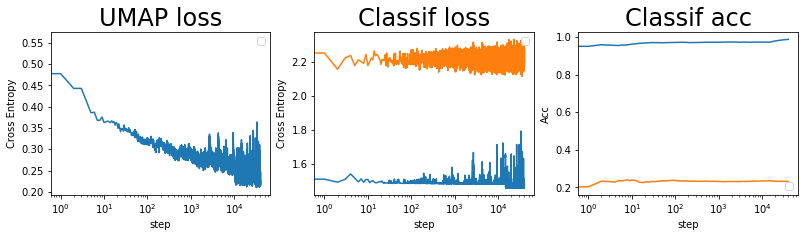

batch: 40000 | train acc: 0.9871 | val acc: 0.2321
leaving epoch because no improvement in 10000 batches


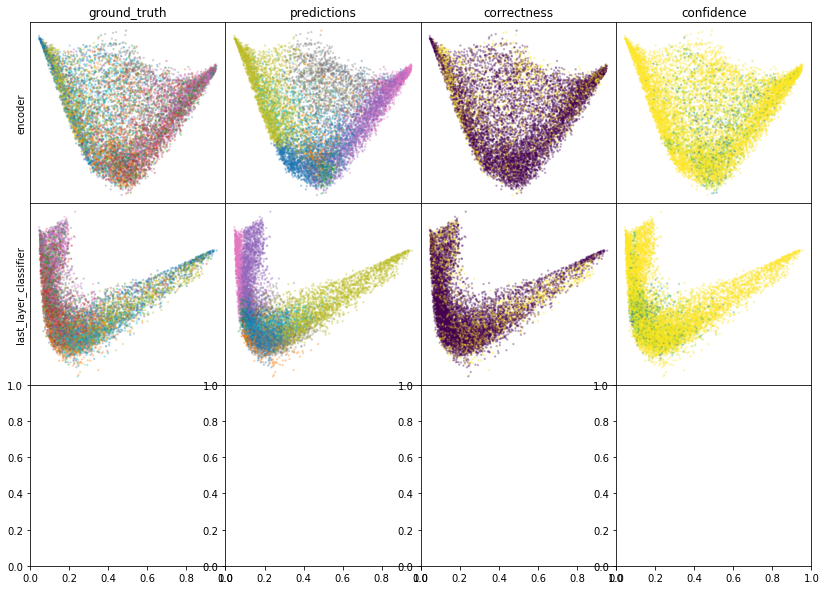

W0806 17:22:25.236522 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:22:25.412427 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:22:25.579850 140328764299008 legend.py:1282] No handles with labels found to put in legend.


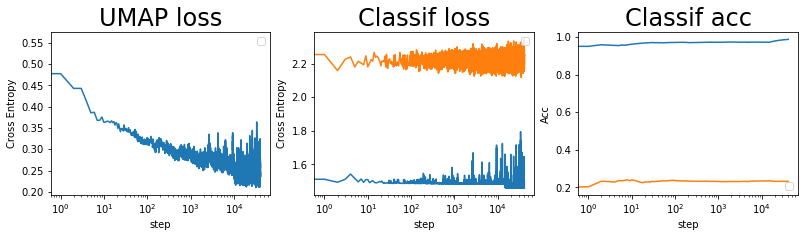

batch: 41000 | train acc: 0.9873 | val acc: 0.2319


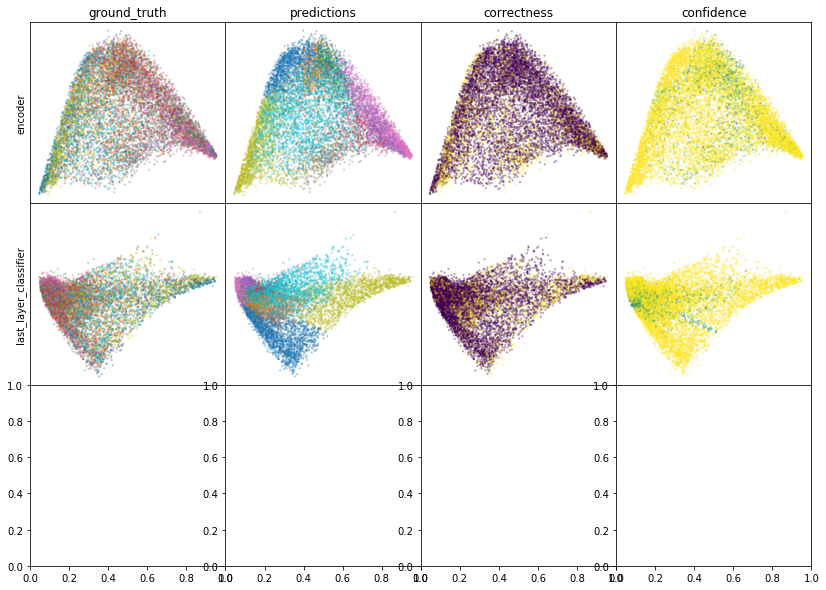

W0806 17:24:11.252271 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:24:11.440452 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:24:11.609163 140328764299008 legend.py:1282] No handles with labels found to put in legend.


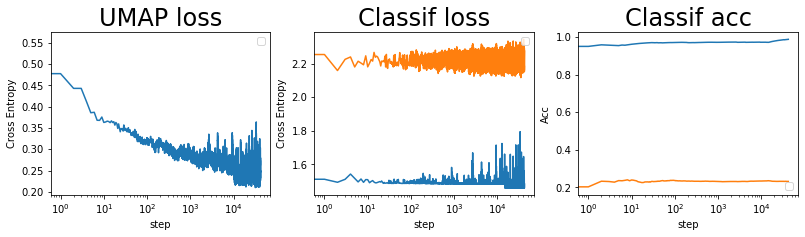

batch: 42000 | train acc: 0.9875 | val acc: 0.232


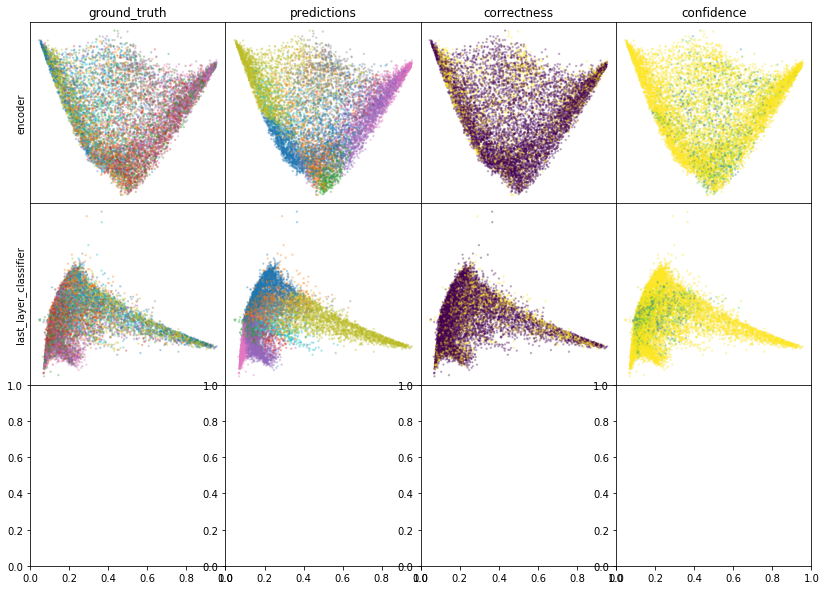

W0806 17:26:29.807186 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:26:29.981126 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:26:30.149749 140328764299008 legend.py:1282] No handles with labels found to put in legend.


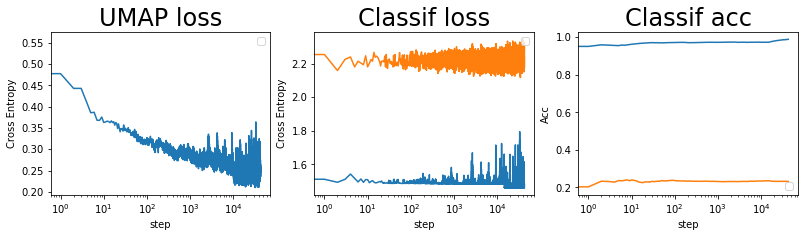

batch: 43000 | train acc: 0.9876 | val acc: 0.2318


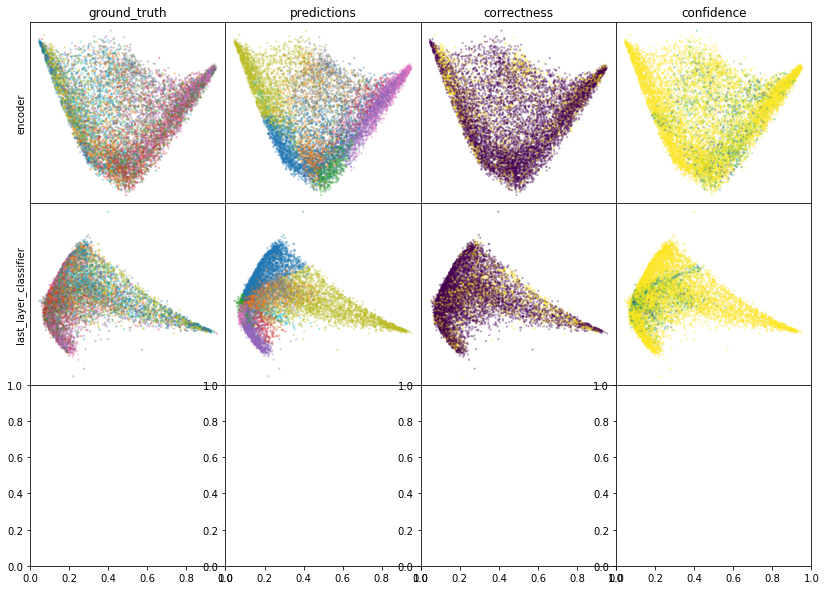

W0806 17:28:15.828101 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:28:16.012155 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:28:16.184444 140328764299008 legend.py:1282] No handles with labels found to put in legend.


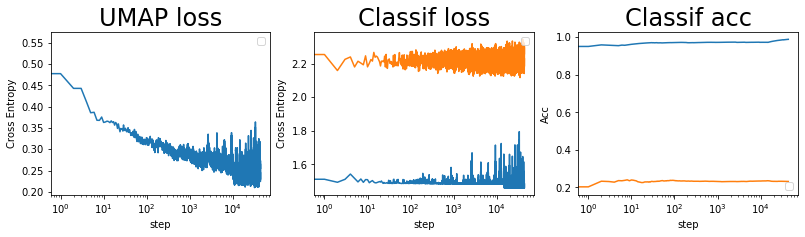

batch: 44000 | train acc: 0.9878 | val acc: 0.2318


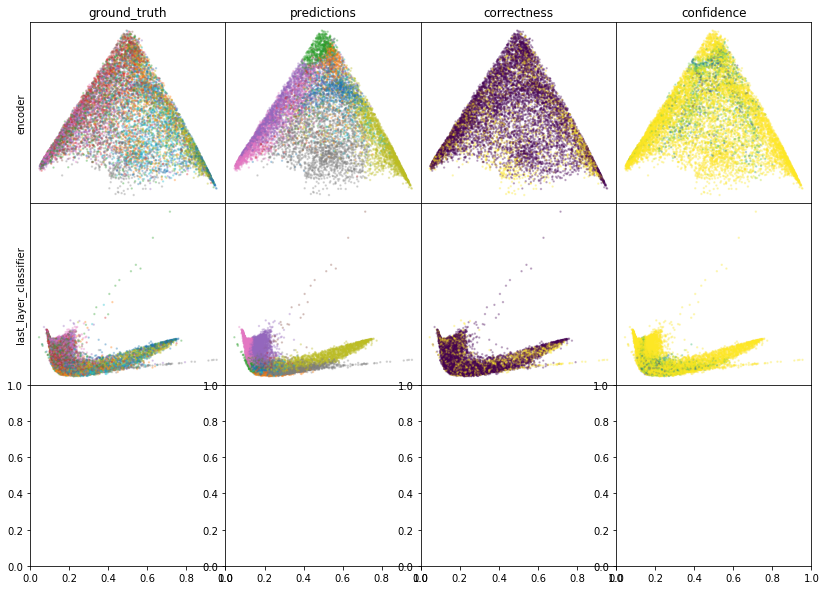

W0806 17:30:36.011428 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:30:36.196237 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:30:36.373820 140328764299008 legend.py:1282] No handles with labels found to put in legend.


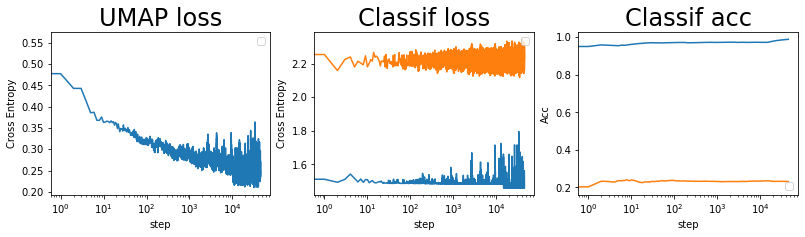

batch: 45000 | train acc: 0.988 | val acc: 0.2317


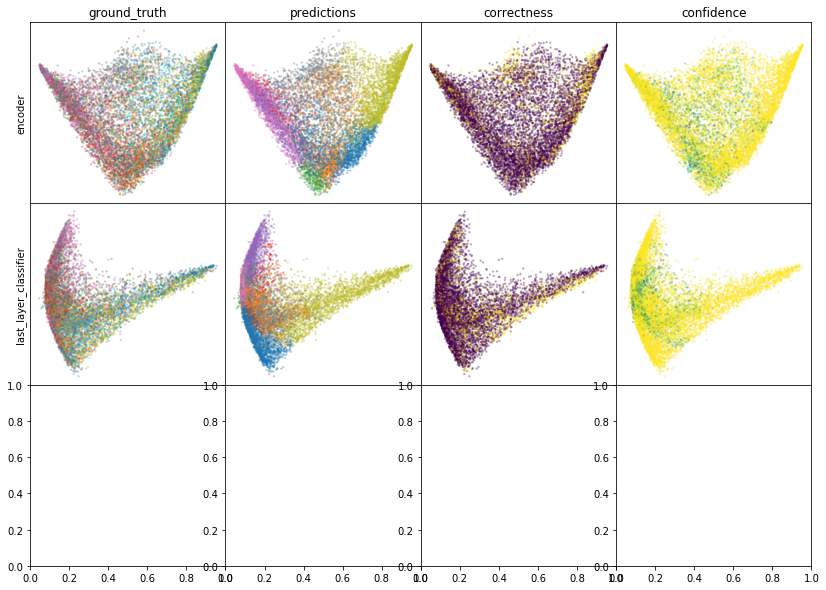

W0806 17:32:23.071929 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:32:23.263357 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:32:23.443136 140328764299008 legend.py:1282] No handles with labels found to put in legend.


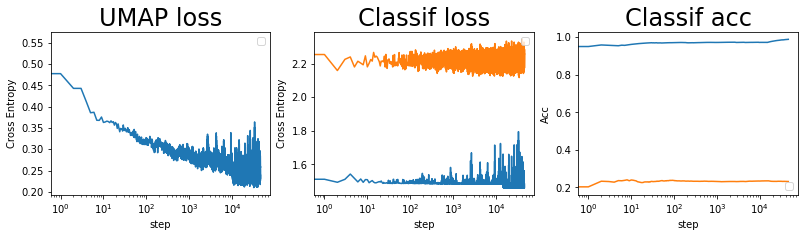

batch: 46000 | train acc: 0.9883 | val acc: 0.2316


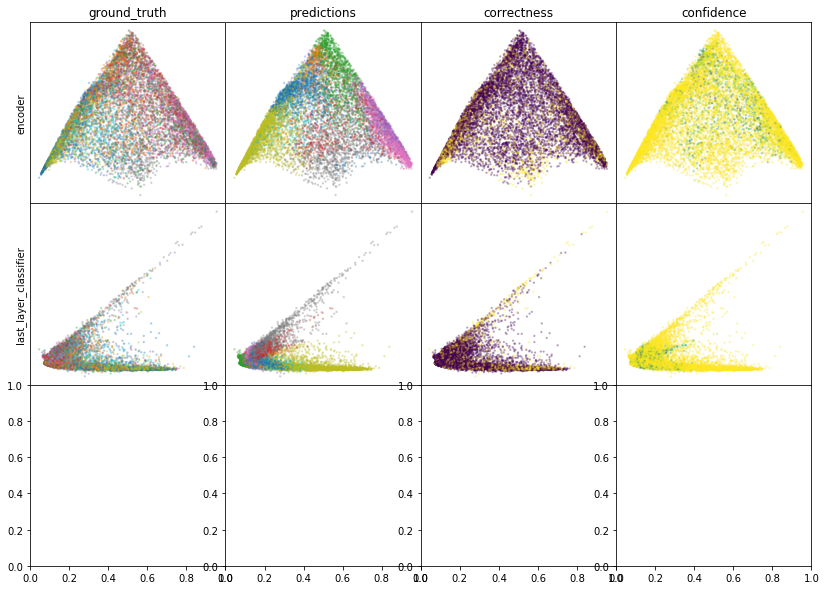

W0806 17:34:43.532750 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:34:43.714322 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:34:43.895591 140328764299008 legend.py:1282] No handles with labels found to put in legend.


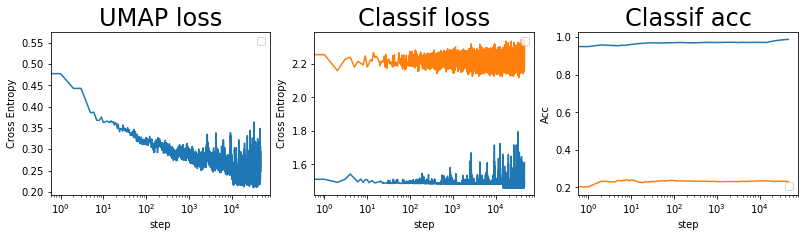

batch: 47000 | train acc: 0.9883 | val acc: 0.2313


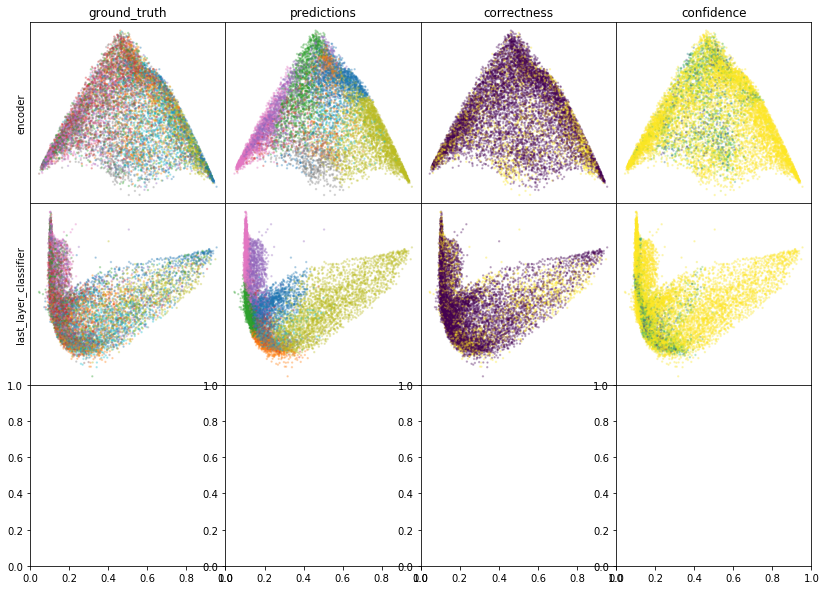

W0806 17:36:31.576716 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:36:31.761407 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:36:31.945611 140328764299008 legend.py:1282] No handles with labels found to put in legend.


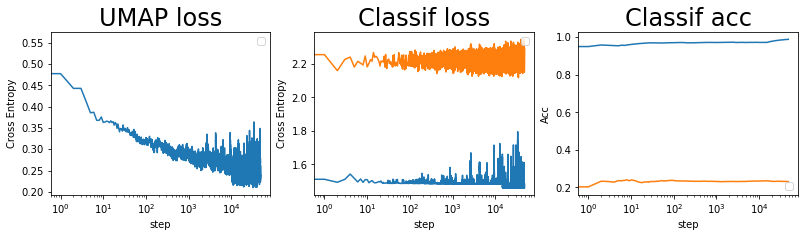

batch: 48000 | train acc: 0.9885 | val acc: 0.2313


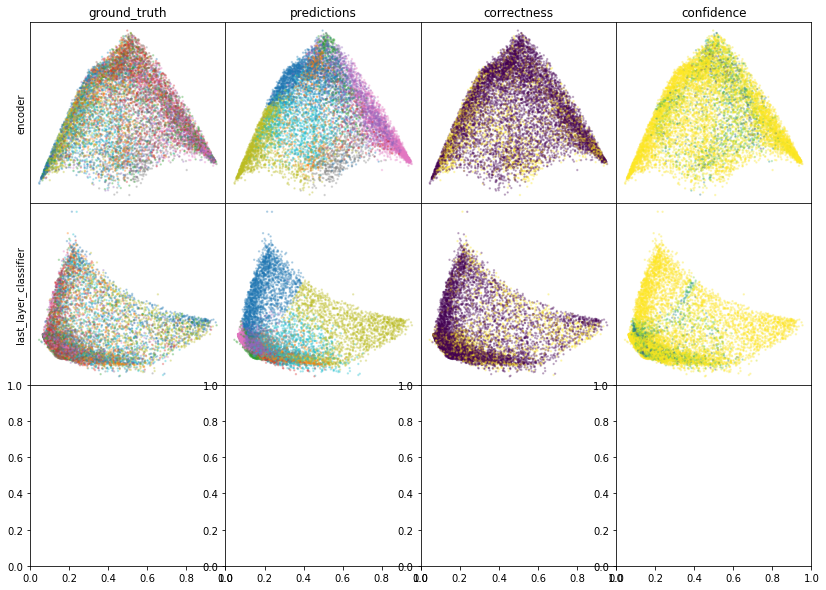

W0806 17:38:54.441976 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:38:54.632631 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:38:54.825852 140328764299008 legend.py:1282] No handles with labels found to put in legend.


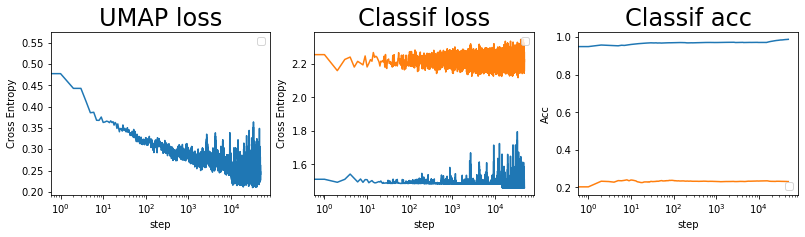

batch: 49000 | train acc: 0.9886 | val acc: 0.2313


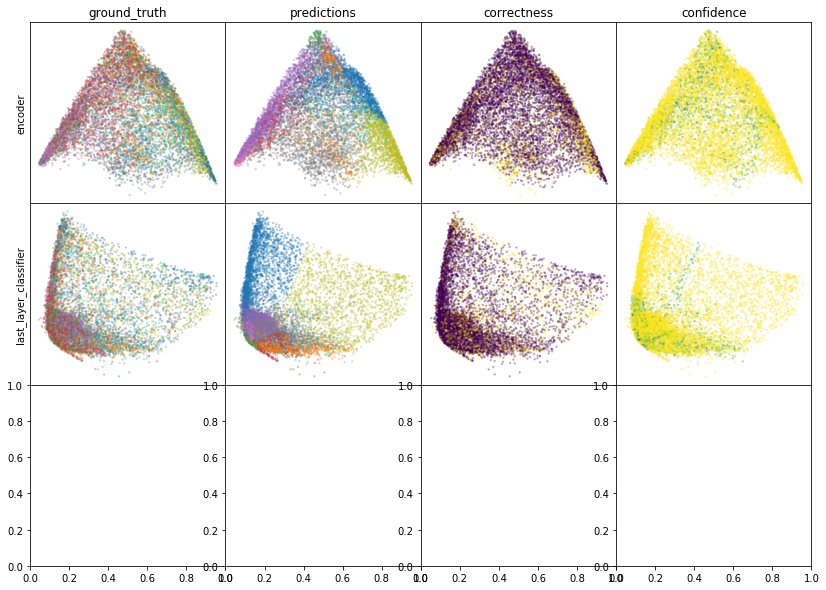

W0806 17:40:43.419660 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:40:43.611850 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:40:43.804230 140328764299008 legend.py:1282] No handles with labels found to put in legend.


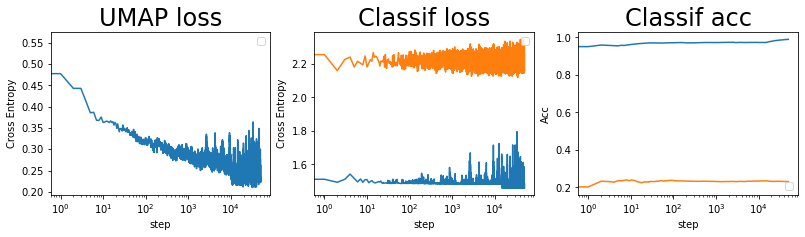

batch: 50000 | train acc: 0.9888 | val acc: 0.2312
leaving epoch because no improvement in 10000 batches


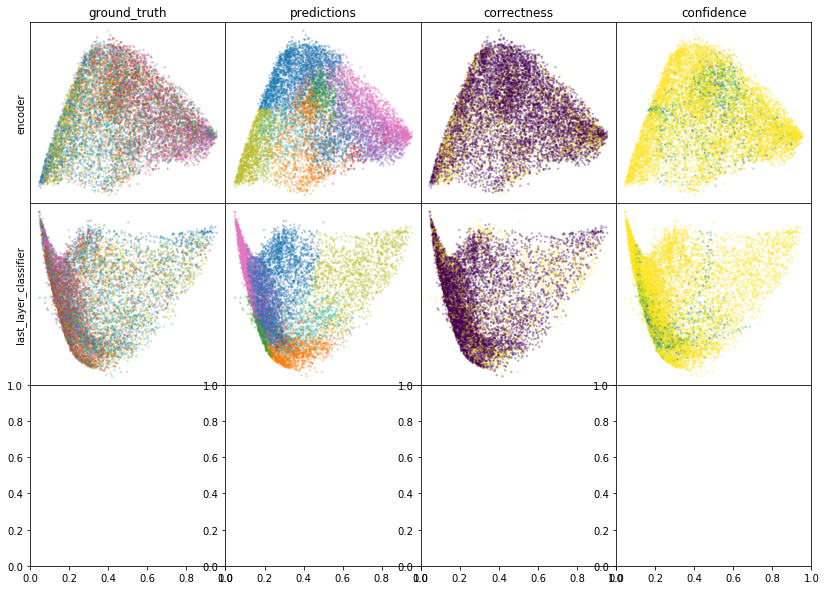

W0806 17:43:57.702423 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:43:57.896293 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:43:58.091467 140328764299008 legend.py:1282] No handles with labels found to put in legend.


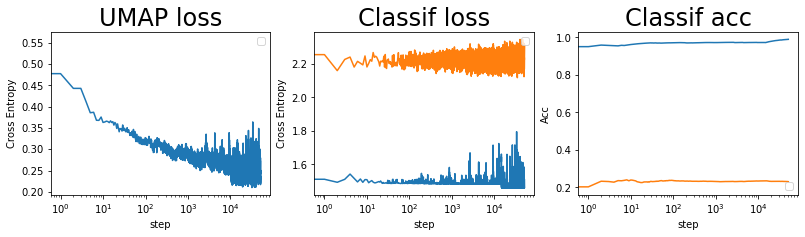

batch: 51000 | train acc: 0.989 | val acc: 0.2309


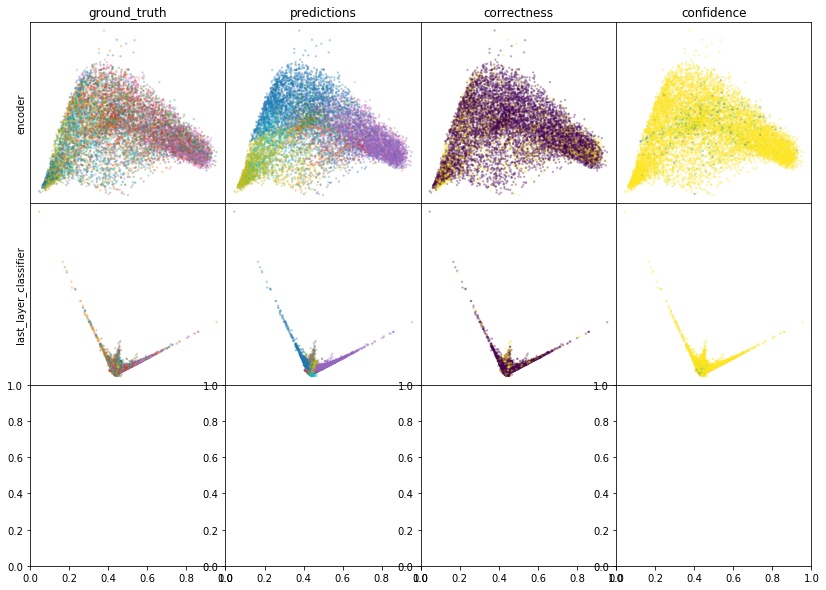

W0806 17:45:47.795311 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:45:47.992409 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:45:48.195105 140328764299008 legend.py:1282] No handles with labels found to put in legend.


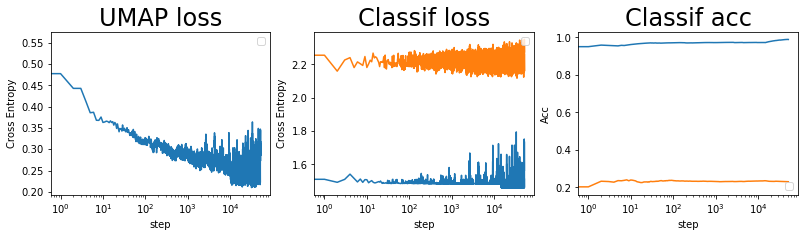

batch: 52000 | train acc: 0.9885 | val acc: 0.2305


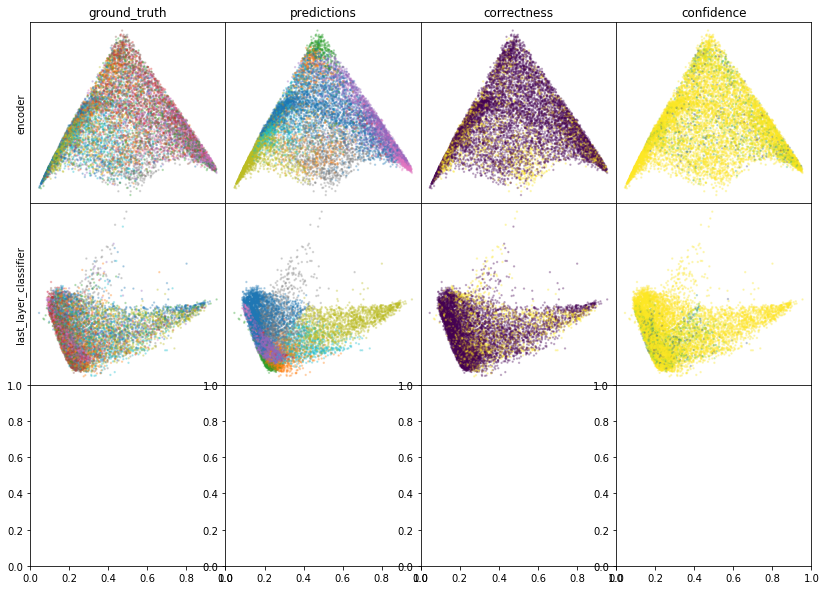

W0806 17:48:10.714953 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:48:10.917700 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:48:11.124035 140328764299008 legend.py:1282] No handles with labels found to put in legend.


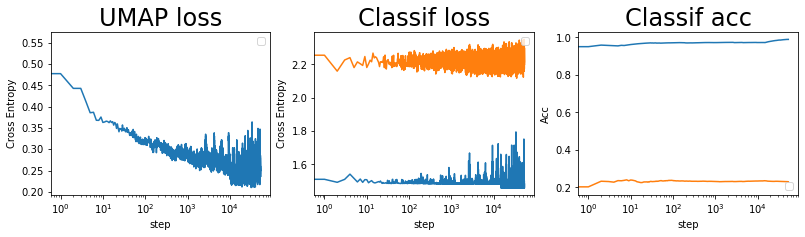

batch: 53000 | train acc: 0.9887 | val acc: 0.2301


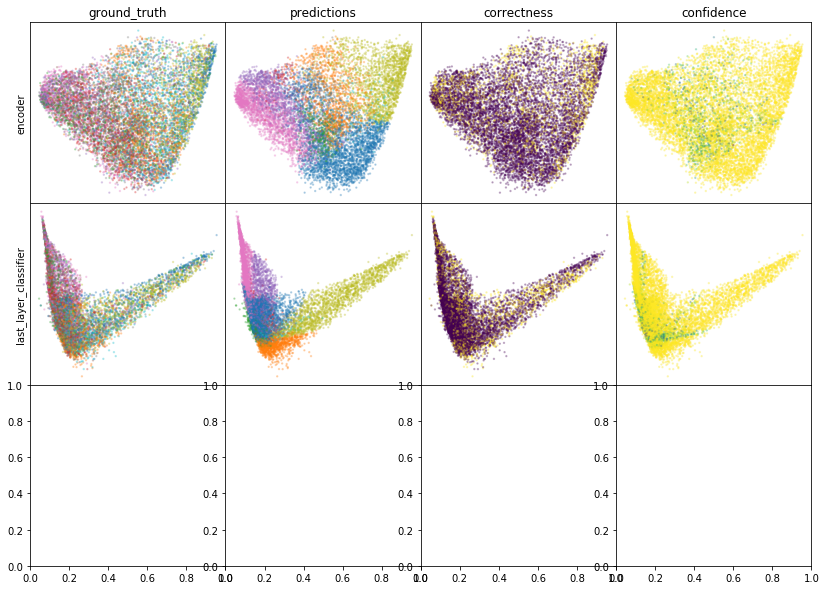

W0806 17:50:01.575877 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:50:01.788314 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:50:01.994846 140328764299008 legend.py:1282] No handles with labels found to put in legend.


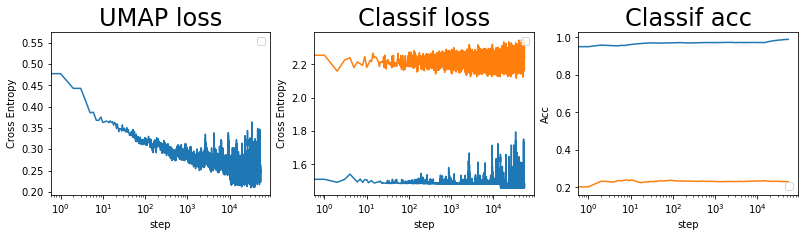

batch: 54000 | train acc: 0.9889 | val acc: 0.2298


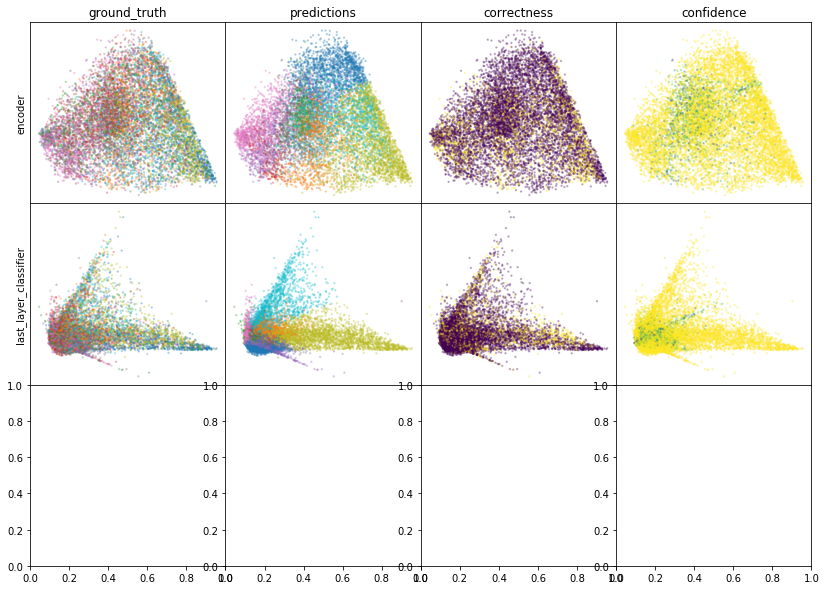

W0806 17:52:25.969810 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:52:26.187404 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:52:26.410480 140328764299008 legend.py:1282] No handles with labels found to put in legend.


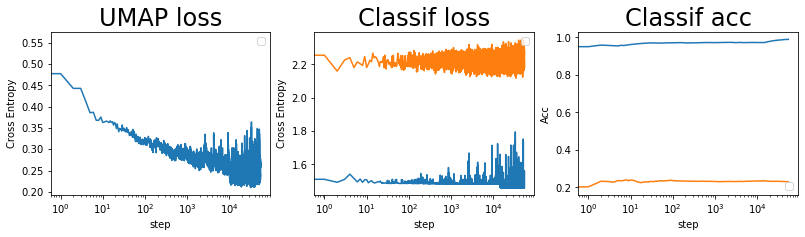

batch: 55000 | train acc: 0.989 | val acc: 0.2296


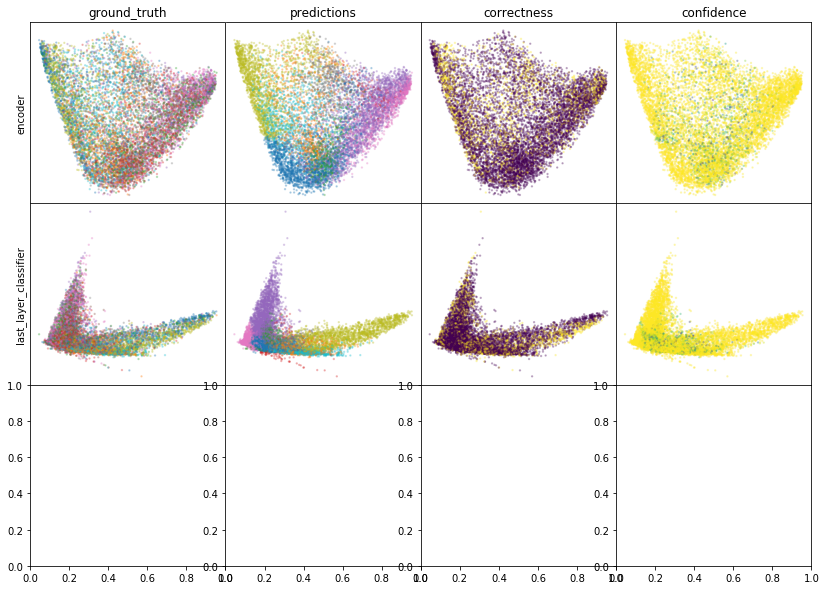

W0806 17:54:17.214472 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:54:17.428579 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:54:17.636082 140328764299008 legend.py:1282] No handles with labels found to put in legend.


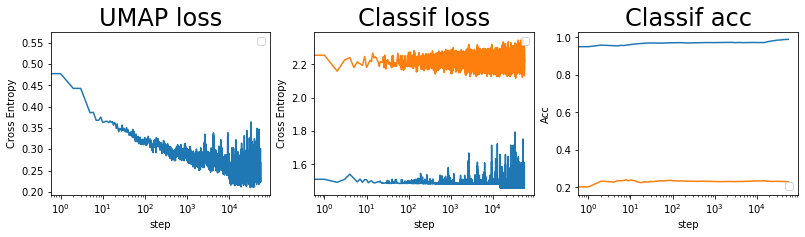

batch: 56000 | train acc: 0.9891 | val acc: 0.2295


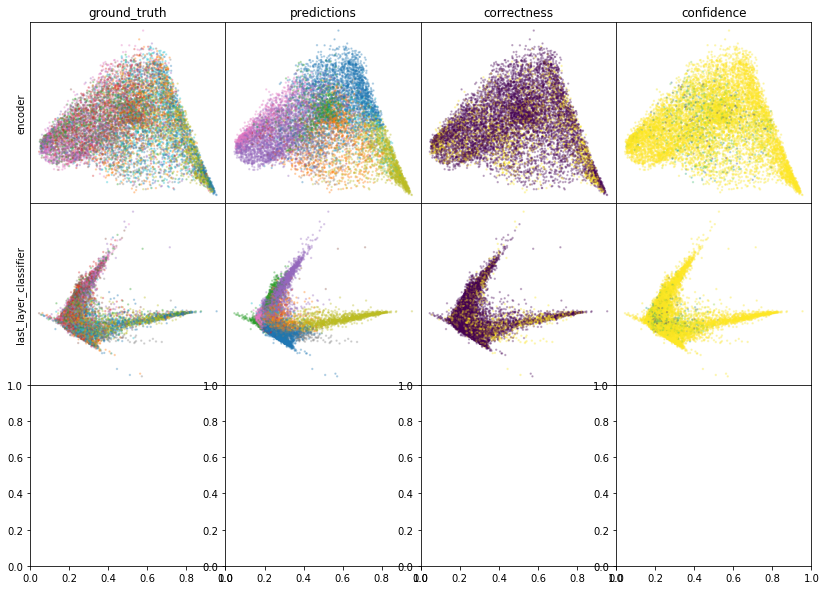

W0806 17:56:42.265604 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:56:42.488828 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:56:42.712724 140328764299008 legend.py:1282] No handles with labels found to put in legend.


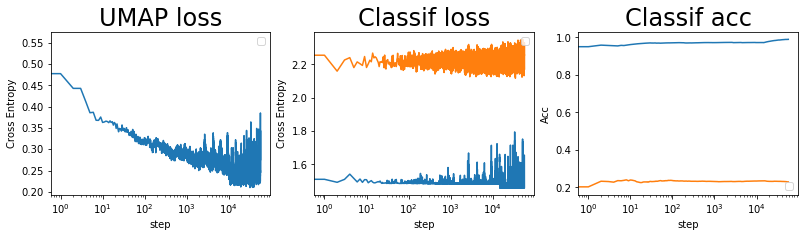

batch: 57000 | train acc: 0.9891 | val acc: 0.2294


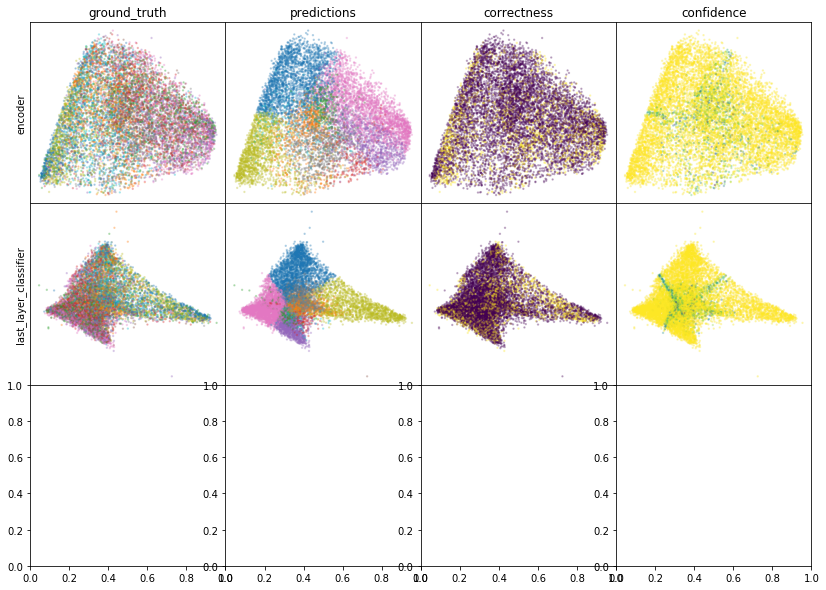

W0806 17:58:35.098254 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:58:35.320391 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 17:58:35.543291 140328764299008 legend.py:1282] No handles with labels found to put in legend.


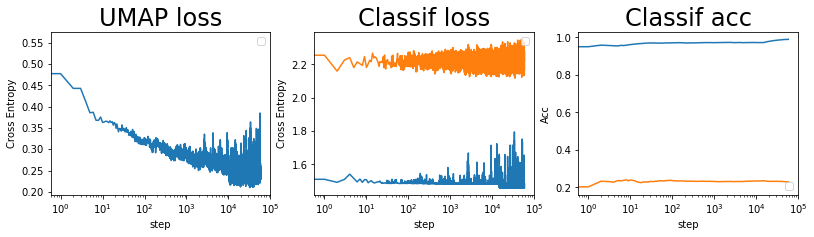

batch: 58000 | train acc: 0.9893 | val acc: 0.2293


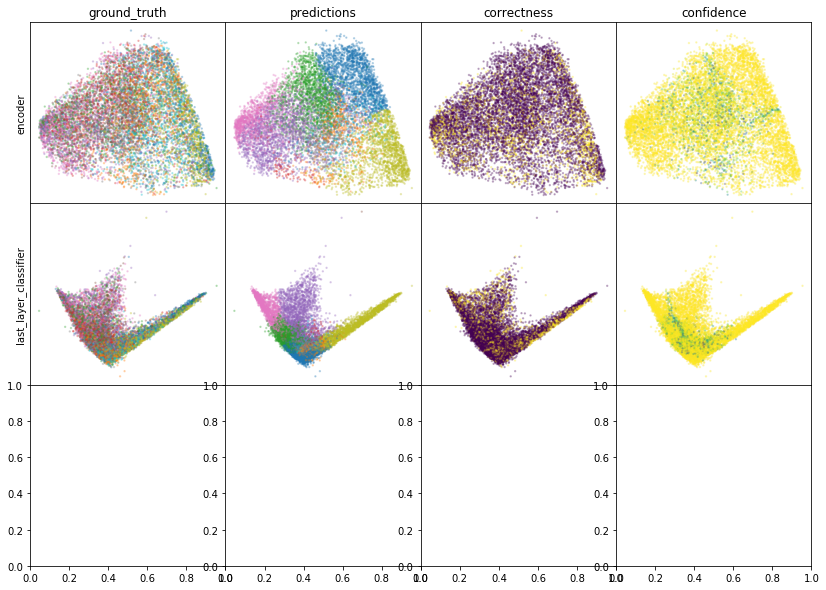

W0806 18:01:01.595577 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:01:01.826518 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:01:02.046780 140328764299008 legend.py:1282] No handles with labels found to put in legend.


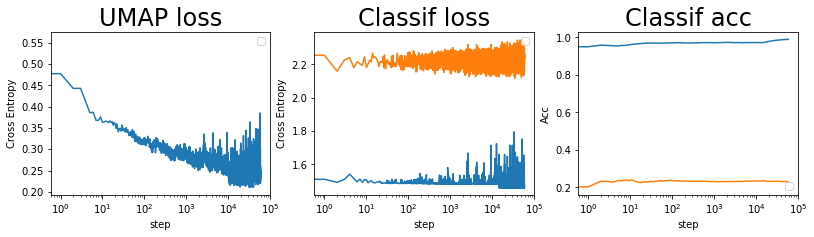

batch: 59000 | train acc: 0.9895 | val acc: 0.2293


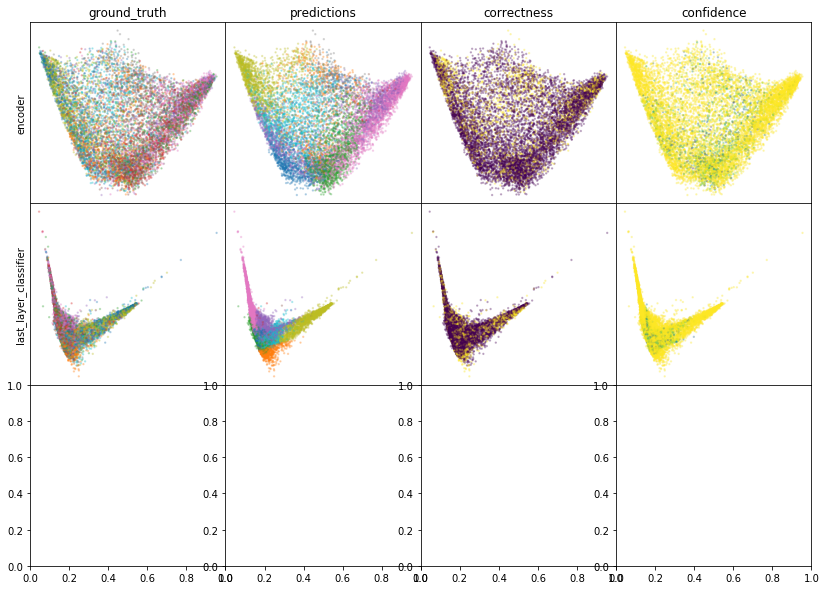

W0806 18:02:56.014742 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:02:56.235157 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:02:56.469271 140328764299008 legend.py:1282] No handles with labels found to put in legend.


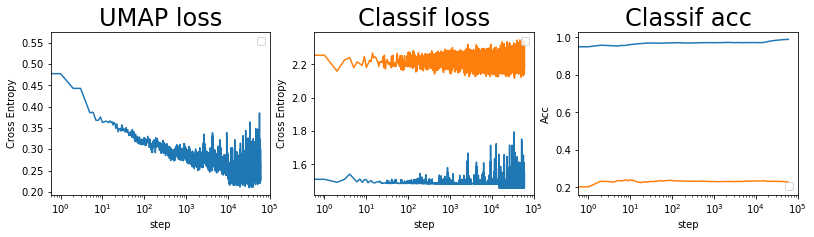

batch: 60000 | train acc: 0.9895 | val acc: 0.2293
leaving epoch because no improvement in 10000 batches


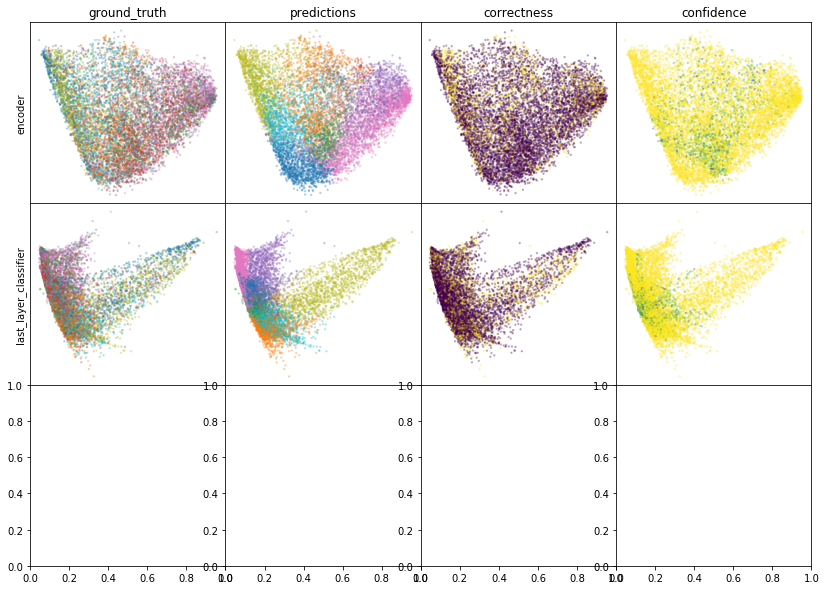

W0806 18:06:14.128286 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:06:14.355066 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:06:14.588089 140328764299008 legend.py:1282] No handles with labels found to put in legend.


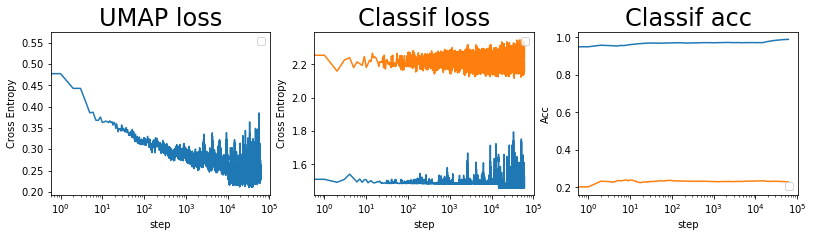

batch: 61000 | train acc: 0.9896 | val acc: 0.2293


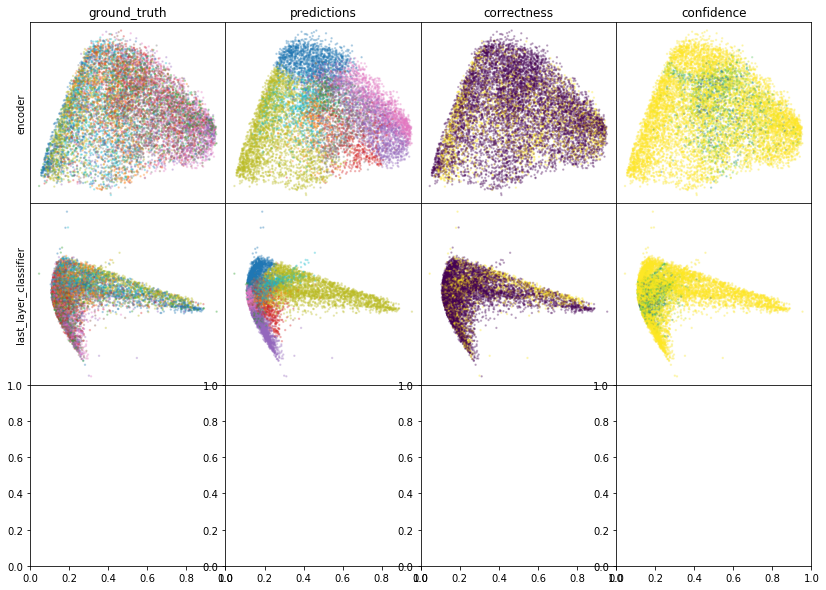

W0806 18:08:08.356903 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:08:08.588139 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:08:08.823144 140328764299008 legend.py:1282] No handles with labels found to put in legend.


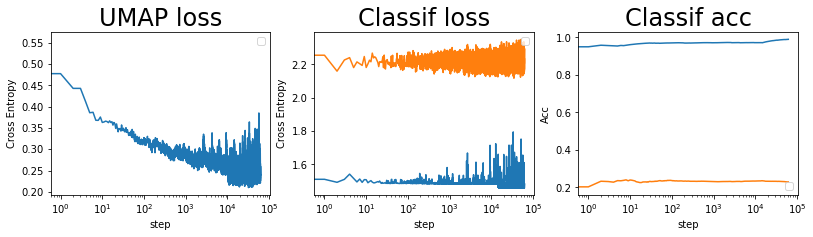

batch: 62000 | train acc: 0.9898 | val acc: 0.2292


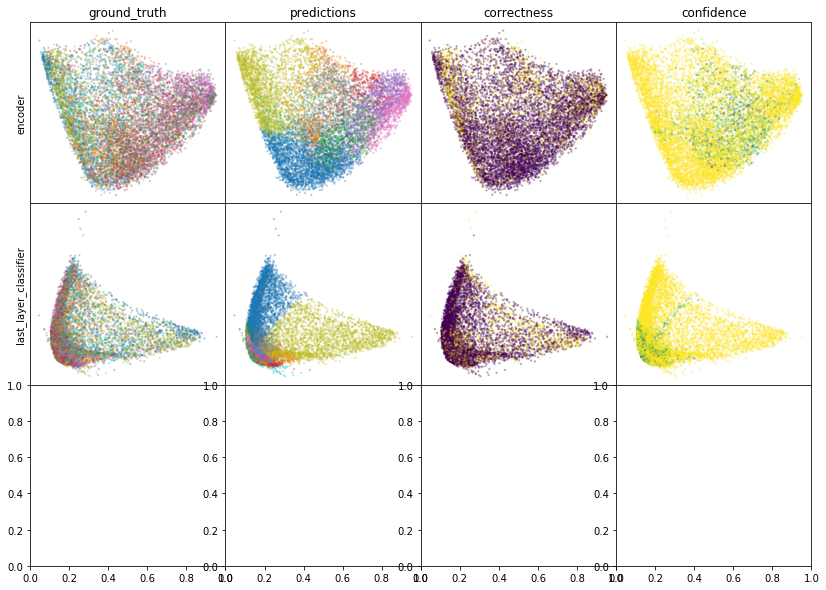

W0806 18:10:35.674613 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:10:35.911587 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:10:36.143340 140328764299008 legend.py:1282] No handles with labels found to put in legend.


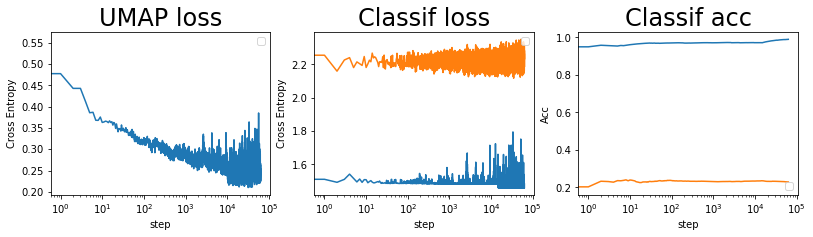

batch: 63000 | train acc: 0.9899 | val acc: 0.2291


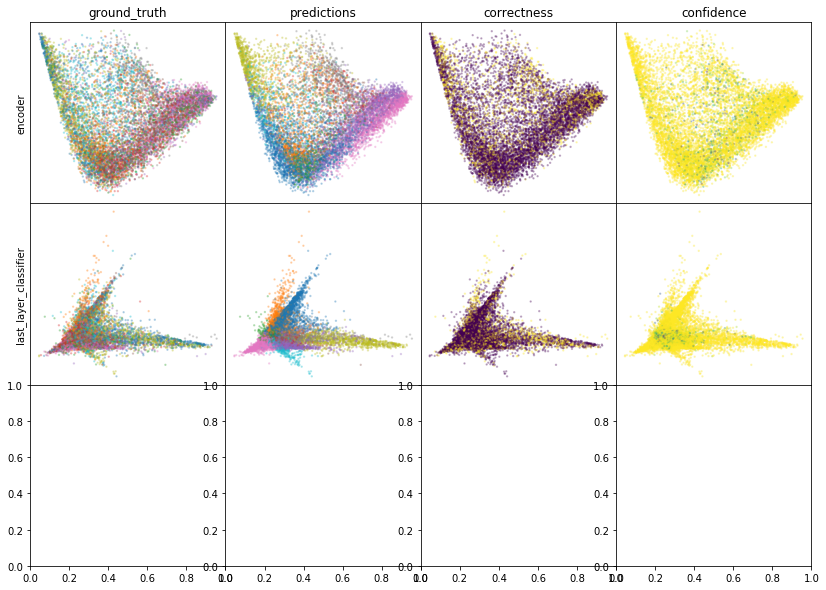

W0806 18:12:30.885142 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:12:31.117869 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:12:31.361134 140328764299008 legend.py:1282] No handles with labels found to put in legend.


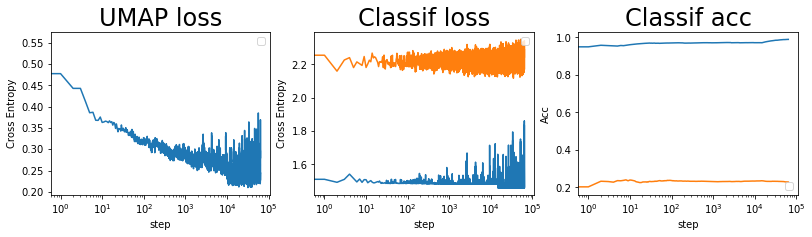

batch: 64000 | train acc: 0.9897 | val acc: 0.2289


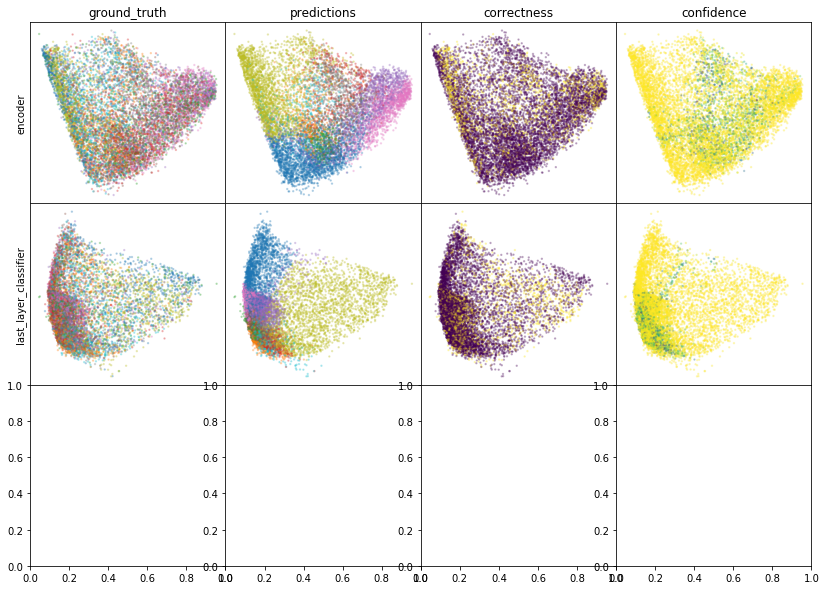

W0806 18:15:00.158233 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:15:00.397101 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:15:00.635853 140328764299008 legend.py:1282] No handles with labels found to put in legend.


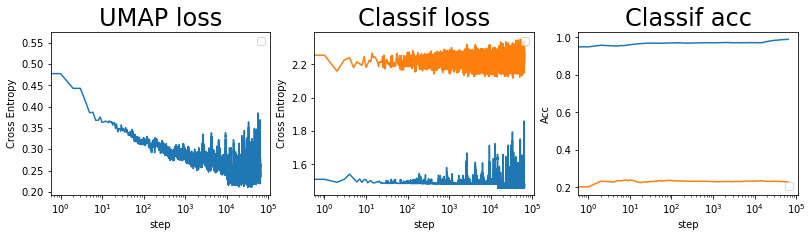

batch: 65000 | train acc: 0.9899 | val acc: 0.2289


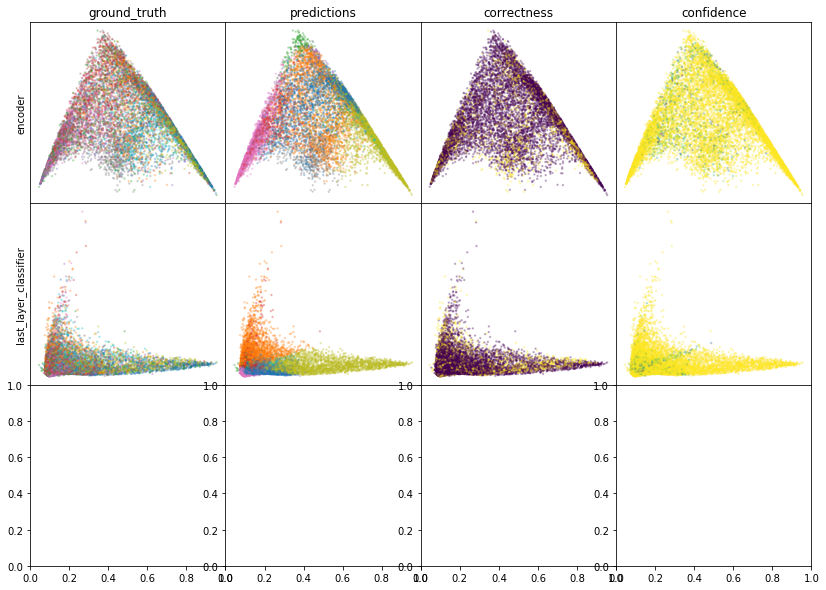

W0806 18:16:55.771854 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:16:56.006149 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:16:56.269596 140328764299008 legend.py:1282] No handles with labels found to put in legend.


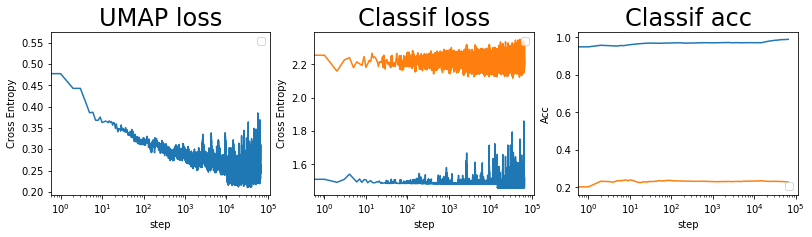

batch: 66000 | train acc: 0.99 | val acc: 0.2287


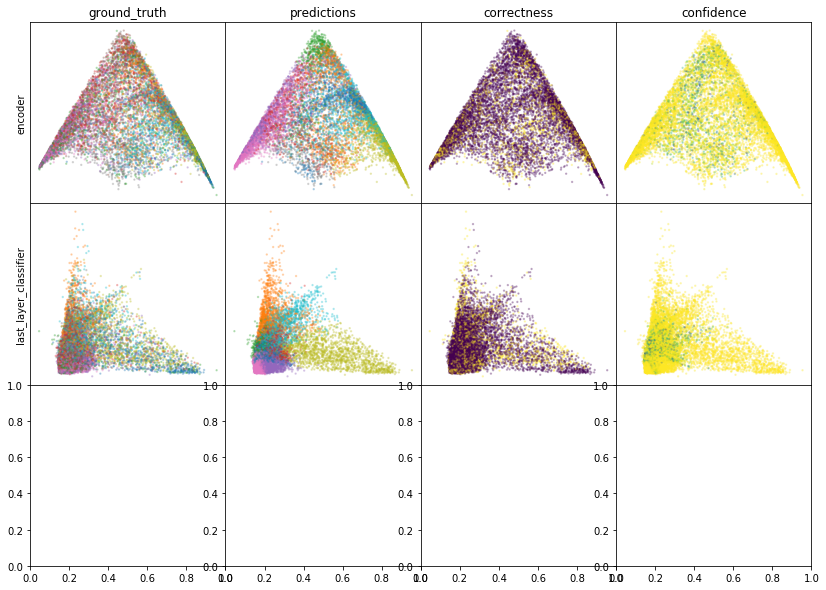

W0806 18:19:24.948584 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:19:25.196577 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:19:25.447530 140328764299008 legend.py:1282] No handles with labels found to put in legend.


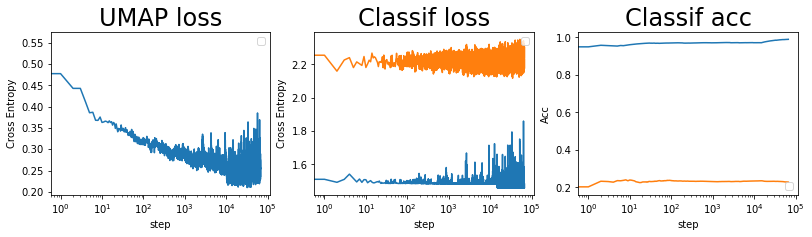

batch: 67000 | train acc: 0.9901 | val acc: 0.2284


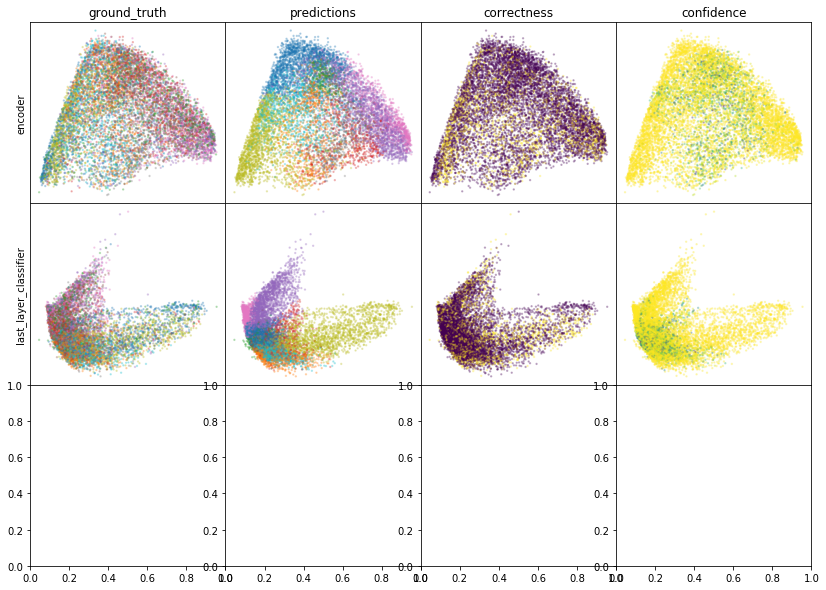

W0806 18:21:21.676739 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:21:21.916916 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:21:22.167414 140328764299008 legend.py:1282] No handles with labels found to put in legend.


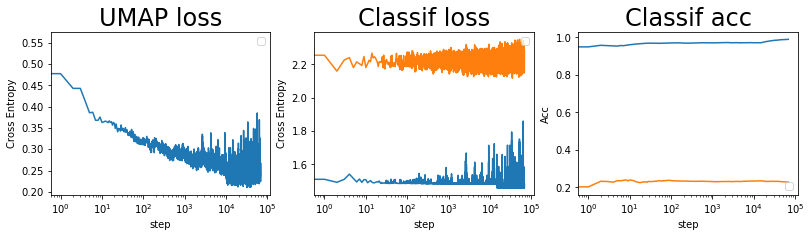

batch: 68000 | train acc: 0.9902 | val acc: 0.2285


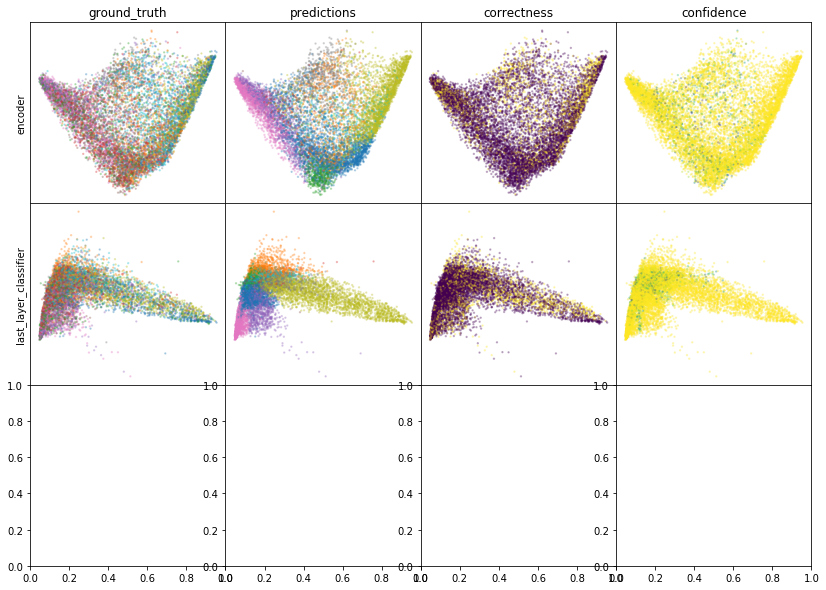

W0806 18:23:52.902088 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:23:53.150938 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:23:53.404820 140328764299008 legend.py:1282] No handles with labels found to put in legend.


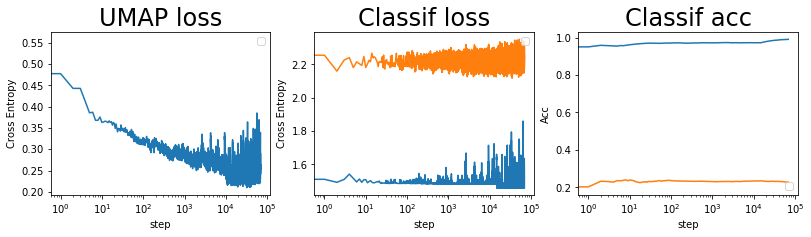

batch: 69000 | train acc: 0.9902 | val acc: 0.2284


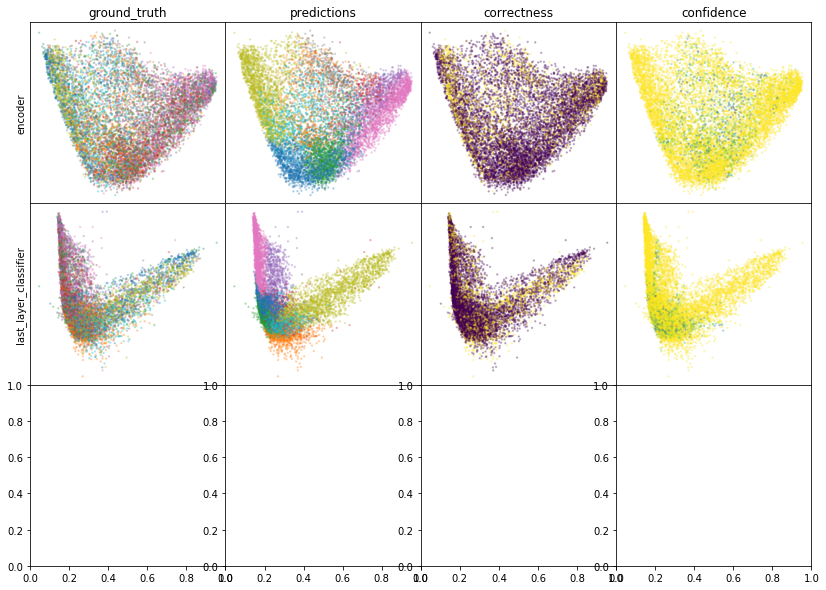

W0806 18:25:51.188339 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:25:51.437224 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:25:51.692509 140328764299008 legend.py:1282] No handles with labels found to put in legend.


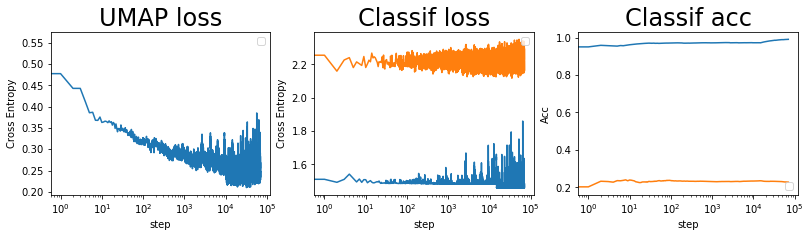

batch: 70000 | train acc: 0.9903 | val acc: 0.2283
leaving epoch because no improvement in 10000 batches
Early stopping because no improvement in 5 epochs


In [51]:
improved_this_epoch = True
for epoch in tqdm(zip(np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"):

    if not improved_this_epoch:
        epochs_without_improvement += 1

    if epochs_without_improvement > max_epochs_without_improvement:
        print(
            "Early stopping because no improvement in {} epochs".format(
                max_epochs_without_improvement
            )
        )
        break

    # reset improvement information
    improved_this_epoch = False
    last_improvement = (
        0  # delta between current batch, and the last batch that was an improvement
    )
    n_reloads = 0
    batches_since_last_reload = 0

    ####  build graph
    # embed data
    train_enc = model_data(X_train, 100, model.encoder)
    train_last_layer = model_data(train_enc, 100, pred_model)

    # construct graph
    umap_graph = build_fuzzy_simplicial_set(
        train_last_layer, y=Y_masked, n_neighbors=n_neighbors,
    )
    # get graph elements
    graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
        umap_graph, n_epochs=200
    )

    # create edge iterator
    edge_epoch, n_edges_per_epoch = create_edge_iterator(
        head,
        tail,
        weight,
        batch_size=batch_size,
        max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
    )

    BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)
    
    samples_left = 0

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(
        edge_epoch, labeled_iter, data_valid
    ):
        
        # redo augmentation if on average, 
        if samples_left <= 0:
            X_train_aug = next(img_data_gen.flow(X_train, shuffle=False, batch_size=len(X_train)))
            samples_left = len(X_train)*repeat_augment_tolerance
        samples_left -= batch_size*2
        
        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(batch_to=X_train_aug[batch_to], batch_from=X_train_aug[batch_from], X=X, y=y, umap_prop = umap_prop)
        
        
        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )
        
        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [52]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.2323


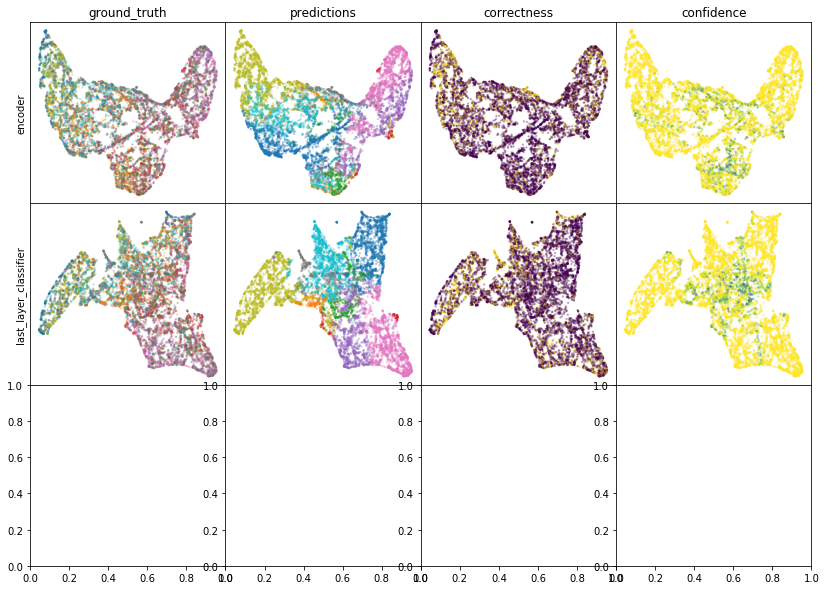

W0806 18:28:57.328211 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:28:57.579195 140328764299008 legend.py:1282] No handles with labels found to put in legend.
W0806 18:28:57.836296 140328764299008 legend.py:1282] No handles with labels found to put in legend.


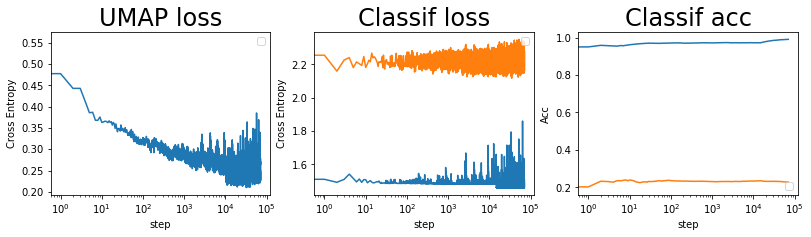

In [53]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=UMAP, cmap='tab10', cmap2='tab10')

In [55]:
test_enc = model_data(X_test, batch_size, model.encoder)

In [56]:
y_pred = model_data(test_enc, batch_size, model.classifier)

In [57]:
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.2342


In [58]:
np.save(cpt_path / 'test_acc.npy', test_acc)